In [1]:
# importing python modules
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
from anndata import read_h5ad
from anndata import read_csv
import anndata
from plotnine import * 
from plotnine.data import mtcars
import venn
from scipy import stats
import seaborn as sns
from scipy.stats import spearmanr
from scipy.sparse import csr_matrix
import glob
from scipy.stats import pearsonr
from venn import venn


%matplotlib inline
sc.logging.print_header()

scanpy==1.8.1 anndata==0.7.5 umap==0.5.1 numpy==1.21.0 scipy==1.6.2 pandas==1.2.3 scikit-learn==0.23.2 statsmodels==0.12.2 python-igraph==0.9.1 louvain==0.7.0 leidenalg==0.8.2 pynndescent==0.5.2


# analysis

In [2]:
sc.settings.set_figure_params(dpi=80)

In [3]:
adata = sc.read_h5ad('MULTI_decontX_raw.h5ad')

In [4]:
adata.obs.groupby(['run_id','Tumor_ID']).apply(len)

run_id    Tumor_ID
PDX1A     H4272        883
          HCI001       767
          HCI002        87
          HCI010        71
PDX1B     H4272       1054
          HCI001       749
          HCI002        98
          HCI010        77
PDX1C     H4272       1069
          HCI001       811
          HCI002       100
          HCI010        89
PDX1D     H4272       1034
          HCI001       761
          HCI002        86
          HCI010        83
PDX2LT    HCI010      1402
PDX2POOL  HCI010        85
PDX3A     H5097        128
          HCI005       700
          HCI011       470
          J2036         41
          J53353      2463
          J55454        80
PDX3B     H5097        130
          HCI005       742
          HCI011       467
          J2036         51
          J53353      2207
          J55454        77
dtype: int64

In [5]:
adata_processed = adata.copy()

In [6]:
adata_processed

AnnData object with n_obs × n_vars = 16862 × 58870
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group'
    layers: 'decontX_counts', 'raw_counts'

In [7]:
adata_processed.obs

,n_counts,n_genes,percent_mito,MULTI_barcode,MULTI_tumor_ID,MULTI_sort,Tumor_ID,run_id,sequencing_batch,sort,receptor_status,ER_receptor,intrinsic_BC_type,ranking_ID,metastatic_potential_rank,metastatic_potential_group
AAACCTGAGCCACTAT-1-0,3061.061523,1204,28.874271,Sample4,H4272,tumor,H4272,PDX1A,1,Tumor,TNBC,ER-,basal,06_H4272,06,low
AAACCTGTCCTTTCGG-1-0,8241.106445,3054,3.121930,Sample2,HCI001,tumor,HCI001,PDX1A,1,Tumor,TNBC,ER-,basal,09_HCI001,09,moderate
AAACCTGTCTTTACAC-1-0,5599.453613,2297,3.691891,Sample4,H4272,tumor,H4272,PDX1A,1,Tumor,TNBC,ER-,basal,06_H4272,06,low
AAACGGGCACCACGTG-1-0,4058.026367,1175,26.499096,Sample4,H4272,tumor,H4272,PDX1A,1,Tumor,TNBC,ER-,basal,06_H4272,06,low
AAACGGGCACCTCGTT-1-0,3332.828613,1231,14.729706,Sample2,HCI001,tumor,HCI001,PDX1A,1,Tumor,TNBC,ER-,basal,09_HCI001,09,moderate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCACATACAGCT-8-7,25212.250000,3714,3.514345,Negative,Negative,Negative,J53353,PDX3B,3,Tumor,TNBC,ER-,basal,12_J53353,12,high
TTTGTCAGTTCCAACA-8-7,19585.318359,3681,5.502220,Negative,Negative,Negative,J53353,PDX3B,3,Tumor,TNBC,ER-,basal,12_J53353,12,high
TTTGTCAGTTCGTCTC-8-7,50338.265625,5625,4.933639,Negative,Negative,Negative,J53353,PDX3B,3,Tumor,TNBC,ER-,basal,12_J53353,12,high
TTTGTCATCCTAGTGA-8-7,20176.990234,3937,1.519440,Negative,Negative,Negative,J53353,PDX3B,3,Tumor,TNBC,ER-,basal,12_J53353,12,high


In [8]:
sc.pp.filter_cells(adata_processed, min_counts=2500)
sc.pp.filter_cells(adata_processed, min_genes=250)
adata_processed = adata_processed[adata_processed.obs.percent_mito < 50, :]

In [9]:
adata_processed

View of AnnData object with n_obs × n_vars = 16862 × 58870
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group'
    layers: 'decontX_counts', 'raw_counts'

In [10]:
adata_processed.obs.groupby(['MULTI_barcode']).apply(len)

MULTI_barcode
Bar1        1415
Bar2         210
Bar3         496
Bar4          55
Bar5         260
Bar6         115
Bar73         85
Bar74       1402
Negative    6104
Sample1       13
Sample2     2344
Sample3        2
Sample4     3787
Sample5      375
Sample6      199
dtype: int64

In [11]:
adata_processed.obs.groupby(['Tumor_ID']).apply(len)

Tumor_ID
H4272     4040
H5097      258
HCI001    3088
HCI002     371
HCI005    1442
HCI010    1807
HCI011     937
J2036       92
J53353    4670
J55454     157
dtype: int64

In [12]:
sc.pp.filter_genes(adata_processed, min_cells=20)
adata_processed

Trying to set attribute `.var` of view, copying.


AnnData object with n_obs × n_vars = 16862 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group'
    var: 'n_cells'
    layers: 'decontX_counts', 'raw_counts'

In [13]:
sc.pp.highly_variable_genes(adata_processed, n_top_genes=2000,flavor='seurat_v3')
sc.pp.normalize_per_cell(adata_processed, counts_per_cell_after=1e4)
sc.pp.log1p(adata_processed)
adata_processed.layers['log1p'] = adata_processed.X
adata_processed.raw = adata_processed

/home/weilun/anaconda3/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.


In [14]:
adata_processed

AnnData object with n_obs × n_vars = 16862 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'log1p'
    layers: 'decontX_counts', 'raw_counts', 'log1p'

## cell cycle genes

In [15]:
cell_cycle_genes = [x.strip() for x in open('files/regev_lab_cell_cycle_genes.txt')]

In [16]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]

## embedding

In [17]:
sc.tl.score_genes_cell_cycle(adata_processed, s_genes=s_genes, g2m_genes=g2m_genes)
sc.pp.regress_out(adata_processed, ['S_score', 'G2M_score'])

... storing 'phase' as categorical


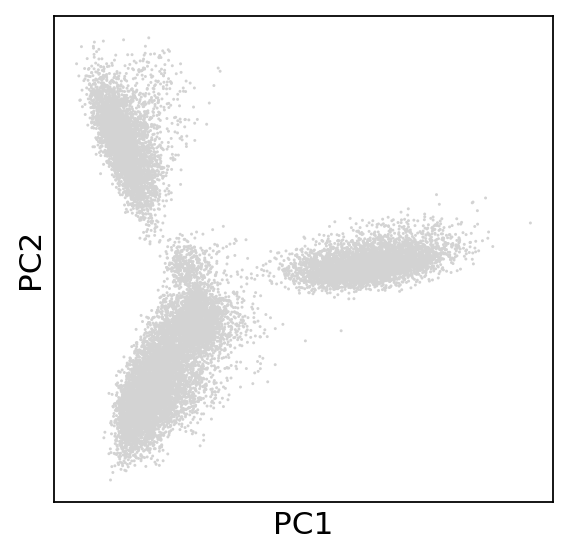

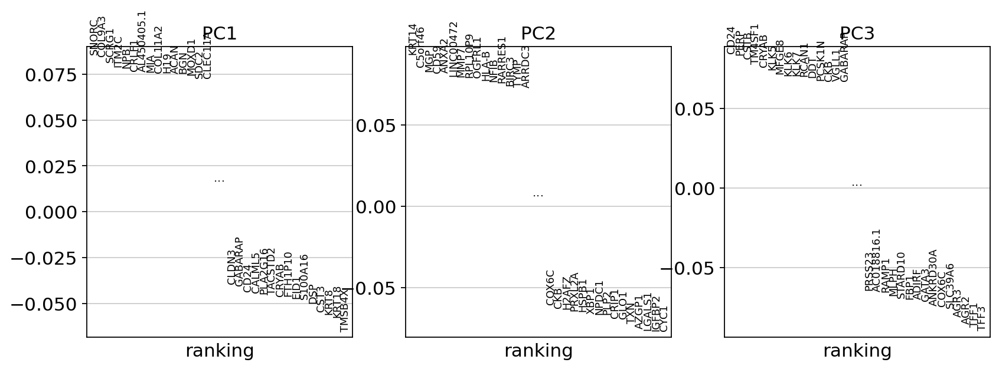

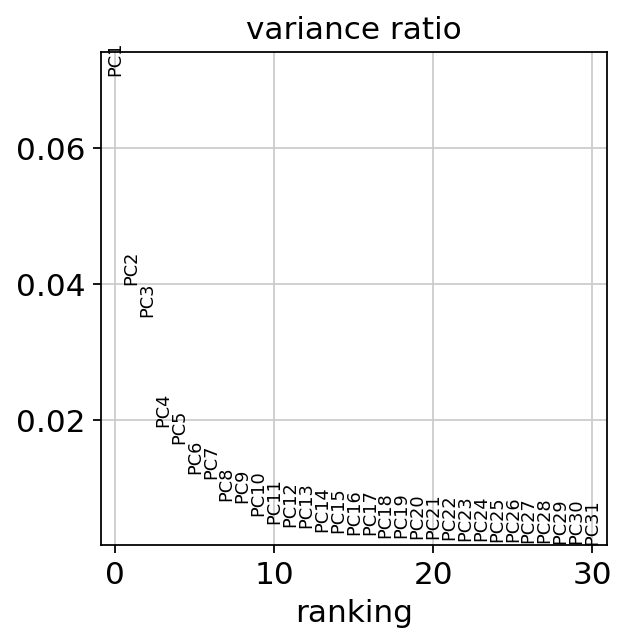

In [18]:
sc.pp.scale(adata_processed,max_value=10)
sc.tl.pca(adata_processed, svd_solver='auto')
sc.pl.pca_overview(adata_processed)

In [19]:
sc.pp.neighbors(adata_processed, n_neighbors=25, n_pcs=20)
sc.tl.louvain(adata_processed, resolution = .5)
sc.tl.leiden(adata_processed, resolution = .5)

In [20]:
sc.tl.umap(adata_processed)

In [21]:
print(set(adata_processed.obs['ER_receptor']))
print(set(adata_processed.obs['Tumor_ID']))

{'ER-', 'ER+'}
{'H4272', 'HCI011', 'H5097', 'J55454', 'J53353', 'HCI001', 'J2036', 'HCI005', 'HCI010', 'HCI002'}


In [22]:
adata_processed.uns['Tumor_ID_colors'] = ['#ccebc5',
 '#bc80bd',
 '#fdb462',
 '#d9d9d9',
 '#fccde5',
 '#1598cc',
 '#bebada',
 '#8dd3c7',
 '#80b1d3',
 '#e8ee88']
                                          
adata_processed.uns['ER_receptor_colors'] = ['#810f7c', '#02818a']           

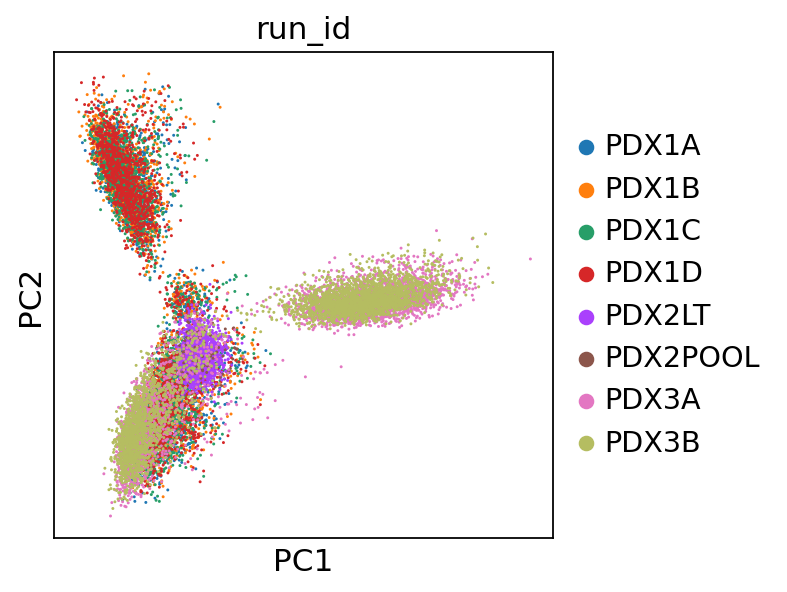

In [23]:
sc.pl.pca(adata_processed, color='run_id')

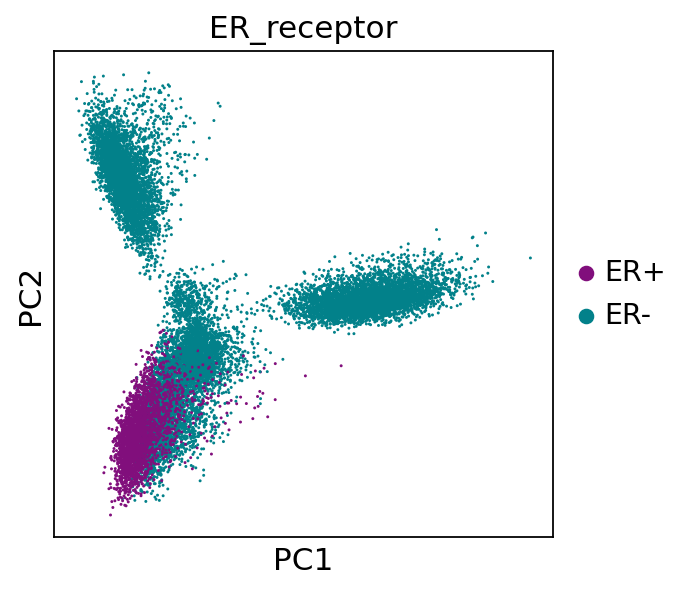

In [24]:
sc.pl.pca(adata_processed, color='ER_receptor')

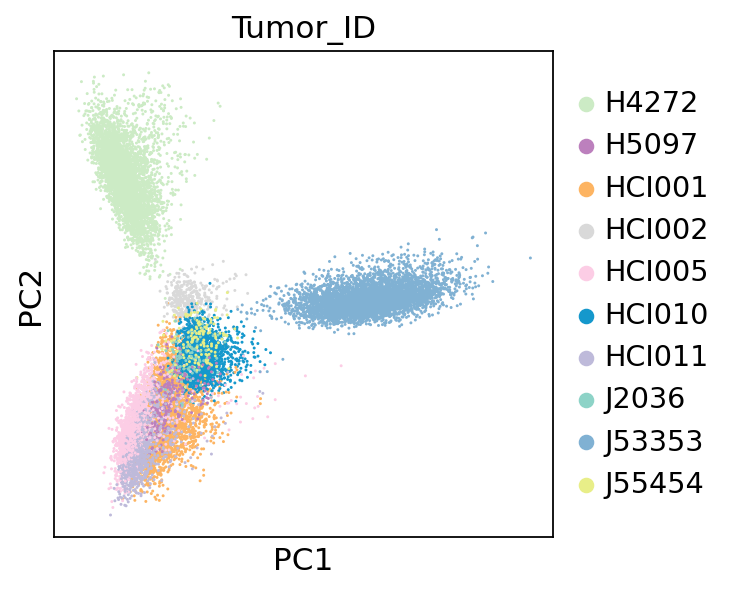

In [25]:
sc.pl.pca(adata_processed, color='Tumor_ID')

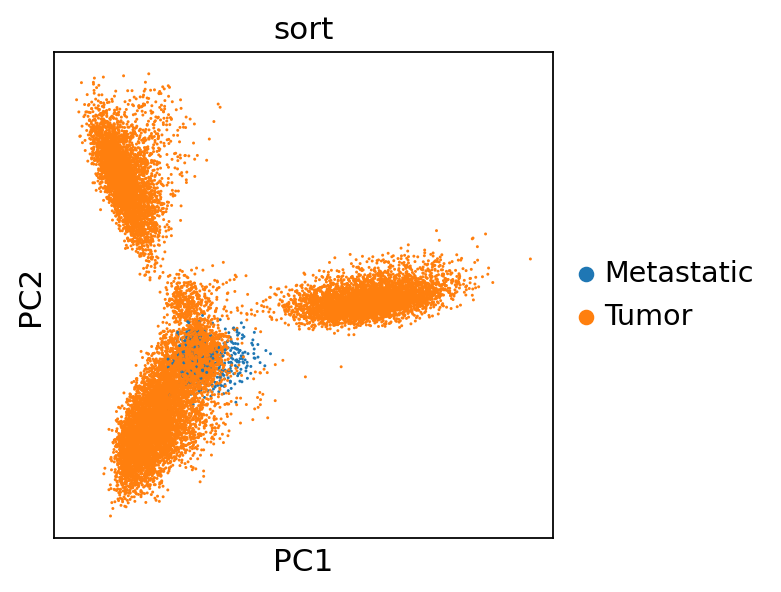

In [26]:
sc.pl.pca(adata_processed, color='sort')

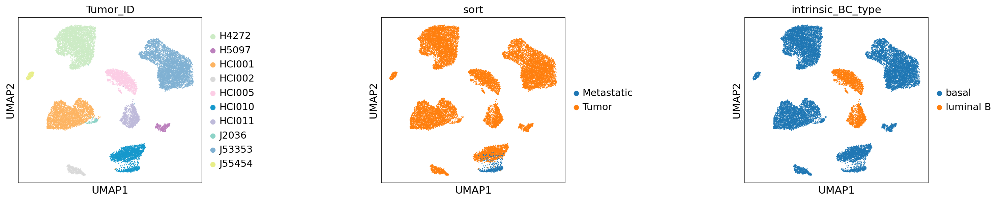

In [27]:
sc.pl.umap(adata_processed, color=['Tumor_ID','sort','intrinsic_BC_type'],wspace=0.8)

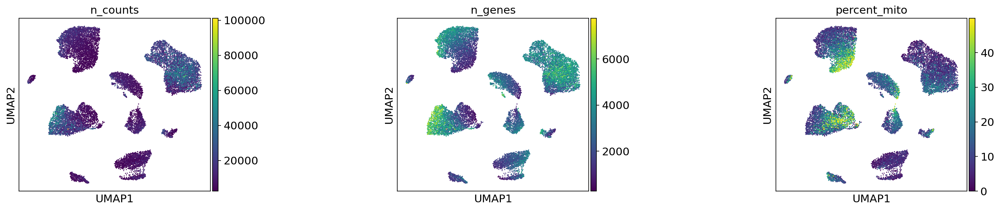

In [28]:
sc.pl.umap(adata_processed, color=['n_counts','n_genes','percent_mito'],wspace=0.8)

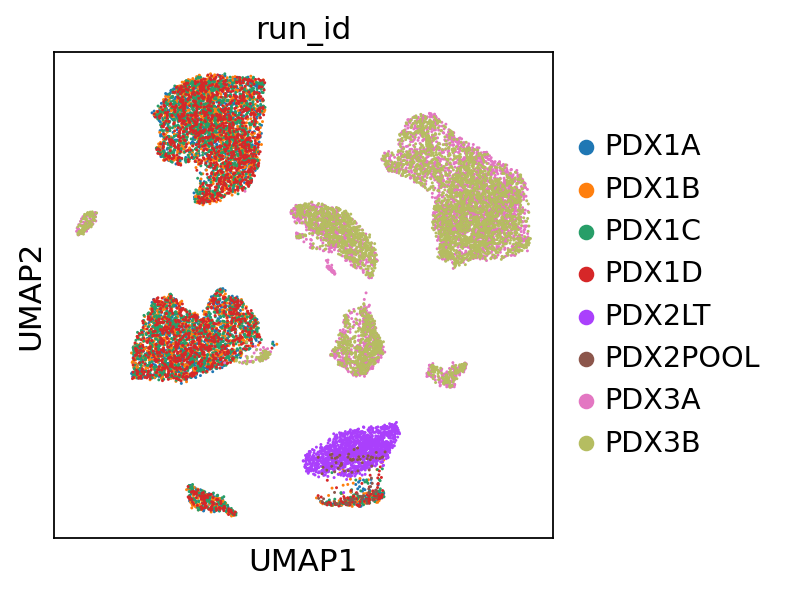

In [29]:
sc.pl.umap(adata_processed, color=['run_id'],wspace=0.8)

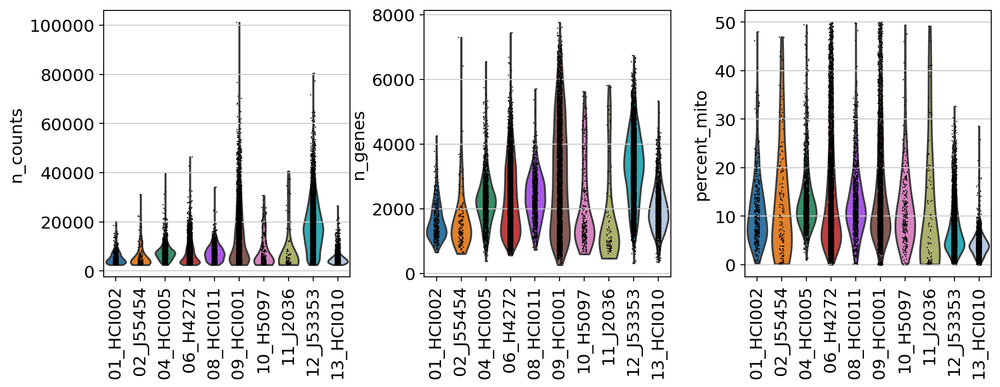

In [30]:
sc.pl.violin(adata_processed, keys = ['n_counts','n_genes','percent_mito'],groupby='ranking_ID',rotation=90)

## Import Tan's EMT genes list

In [31]:
Tan = pd.read_csv('files/tan_EMT_csv.csv',header = 1)
Tan = Tan.loc[Tan['Category'].isin(['Epi','Mes'])]
Tan_Epi = Tan.loc[Tan['Category'].isin(['Epi'])]['Index'].tolist()
Tan_Mes = Tan.loc[Tan['Category'].isin(['Mes'])]['Index'].tolist()

In [32]:
Tan_E = []
for i in Tan_Epi:
    Tan_E.append(i.split(' ')[1])
    
    
Tan_M = []
for i in Tan_Mes:
    Tan_M.append(i.split(' ')[1])

In [33]:
Tan_E.remove('C1orf106')
Tan_E.append('INAVA')
Tan_E.remove('PPAP2C')
Tan_E.append('PLPP2')
Tan_E.remove('C19orf21')
Tan_E.append('MISP')
Tan_E.remove('GPR56')
Tan_E.append('ADGRG1')

In [34]:
Tan_M.remove('C14orf139')
Tan_M.append('SYNE3')
Tan_M.remove('PTRF')
Tan_M.append('CAVIN1')
Tan_M.remove('LHFP')
Tan_M.append('LHFPL6')
Tan_M.remove('GUCY1B3')
Tan_M.append('GUCY1B1')
Tan_M.remove('KIAA1462')
Tan_M.append('JCAD')

In [35]:
Tan_E.sort()
Tan_M.sort()

In [36]:
Tan_E_Modi = []
Tan_M_Modi = []

for i in Tan_E:
    if i in adata_processed.var.index:
        Tan_E_Modi.append(i)
        
for i in Tan_M:
    if i in adata_processed.var.index:
        Tan_M_Modi.append(i)

In [37]:
print(len(Tan_E_Modi))
print(len(Tan_M_Modi))

142
142


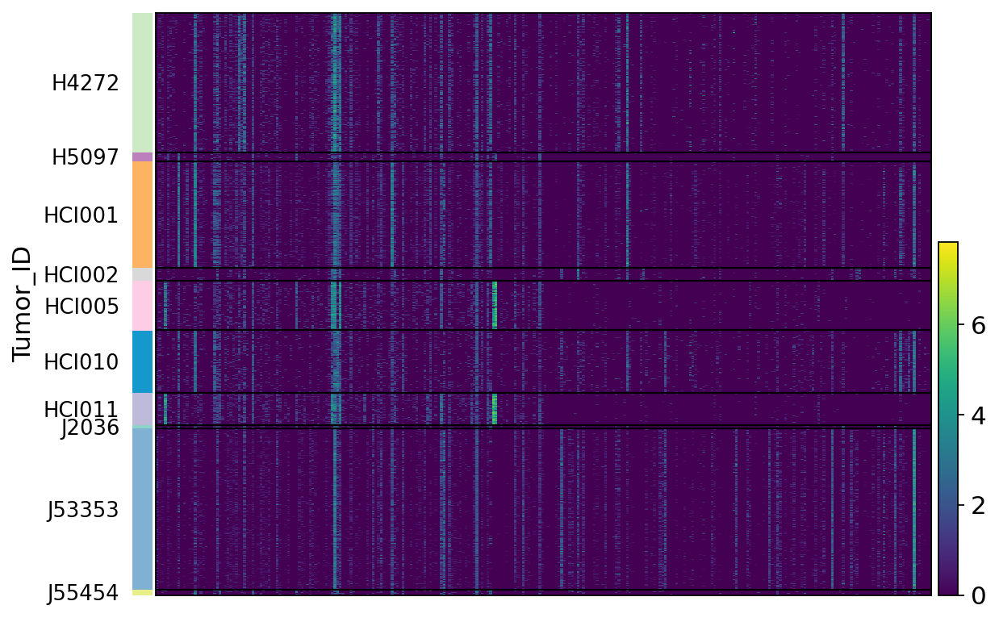

In [38]:
sc.pl.heatmap(adata_processed,Tan_E_Modi+Tan_M_Modi,groupby='Tumor_ID')

In [39]:
adata_processed_gsva = adata_processed.copy()
adata_processed_gsva.X = adata_processed_gsva.raw.X
adata_processed_gsva.X

array([[0.       , 0.       , 0.       , ..., 0.       , 5.164885 ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 2.5584648,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 3.1196938,
        0.       ],
       ...,
       [0.       , 0.       , 0.       , ..., 0.       , 3.0972822,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 1.8001239,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.       , 3.6490216,
        0.5768922]], dtype=float32)

In [40]:
adata_processed_gsva.T.to_df().to_csv('files/MULTI_gsva_gc.csv')

## running GSVA

In [41]:
"""
 
 using GSVA_scoring.Rmd script to run GSVA

"""

'\n \n using GSVA_scoring.Rmd script to run GSVA\n\n'

## import gsva

In [42]:
gsva_out = pd.read_csv('files/gsva_out_MULTI.csv',index_col=0)
gsva_out.index.name = 'GS'
gsva_out=gsva_out.T

In [43]:
gsva_out

GS,Epi,Mes,combined
AAACCTGAGCCACTAT.1.0,-0.230684,-0.175436,-0.207458
AAACCTGTCCTTTCGG.1.0,-0.005601,-0.152973,-0.066680
AAACCTGTCTTTACAC.1.0,-0.241318,-0.198665,-0.225807
AAACGGGCACCACGTG.1.0,-0.215355,-0.187617,-0.205729
AAACGGGCACCTCGTT.1.0,-0.237576,-0.190947,-0.220099
...,...,...,...
TTTGTCACATACAGCT.8.7,-0.405807,0.125637,-0.199188
TTTGTCAGTTCCAACA.8.7,-0.405343,0.086573,-0.208091
TTTGTCAGTTCGTCTC.8.7,-0.414896,0.026527,-0.219963
TTTGTCATCCTAGTGA.8.7,-0.276916,0.299085,-0.044371


In [44]:
gsva_out.index = [i.split('.')[0]+'-'+i.split('.')[1]+'-'+i.split('.')[2] for i in gsva_out.index]
gsva_out

GS,Epi,Mes,combined
AAACCTGAGCCACTAT-1-0,-0.230684,-0.175436,-0.207458
AAACCTGTCCTTTCGG-1-0,-0.005601,-0.152973,-0.066680
AAACCTGTCTTTACAC-1-0,-0.241318,-0.198665,-0.225807
AAACGGGCACCACGTG-1-0,-0.215355,-0.187617,-0.205729
AAACGGGCACCTCGTT-1-0,-0.237576,-0.190947,-0.220099
...,...,...,...
TTTGTCACATACAGCT-8-7,-0.405807,0.125637,-0.199188
TTTGTCAGTTCCAACA-8-7,-0.405343,0.086573,-0.208091
TTTGTCAGTTCGTCTC-8-7,-0.414896,0.026527,-0.219963
TTTGTCATCCTAGTGA-8-7,-0.276916,0.299085,-0.044371


In [45]:
for i in gsva_out.index:
    adata_processed.obs.loc[i, 'E_score'] = gsva_out.loc[i, 'Epi']
    adata_processed.obs.loc[i, 'M_score'] = gsva_out.loc[i, 'Mes']
    adata_processed.obs.loc[i, 'EMP_score'] = adata_processed.obs.loc[i, 'M_score'] - adata_processed.obs.loc[i, 'E_score']

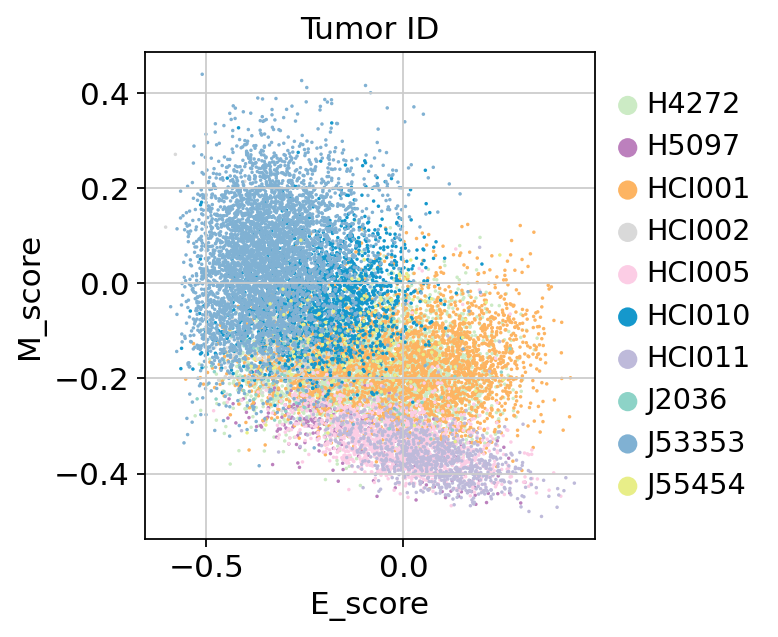

In [46]:
sc.pl.scatter(adata_processed, x='E_score',y='M_score',color='Tumor_ID',size=10)

In [47]:
adata_processed.obs['EMP_stage'] = 'EMP Intermediate'
for i in adata_processed.obs.index:
    if adata_processed.obs.loc[i, 'EMP_score'] < -0.2:
        adata_processed.obs.loc[i,'EMP_stage']  = 'Epithelial-like'
    if adata_processed.obs.loc[i, 'EMP_score'] > 0.2:
        adata_processed.obs.loc[i,'EMP_stage']  = 'Mesenchymal-like'

In [48]:
print(set(adata_processed.obs['EMP_stage']))

{'EMP Intermediate', 'Epithelial-like', 'Mesenchymal-like'}


In [49]:
adata_processed.uns['EMP_stage_colors'] = ['#BC80B7', '#81B1D3', '#F47F72']  

... storing 'EMP_stage' as categorical


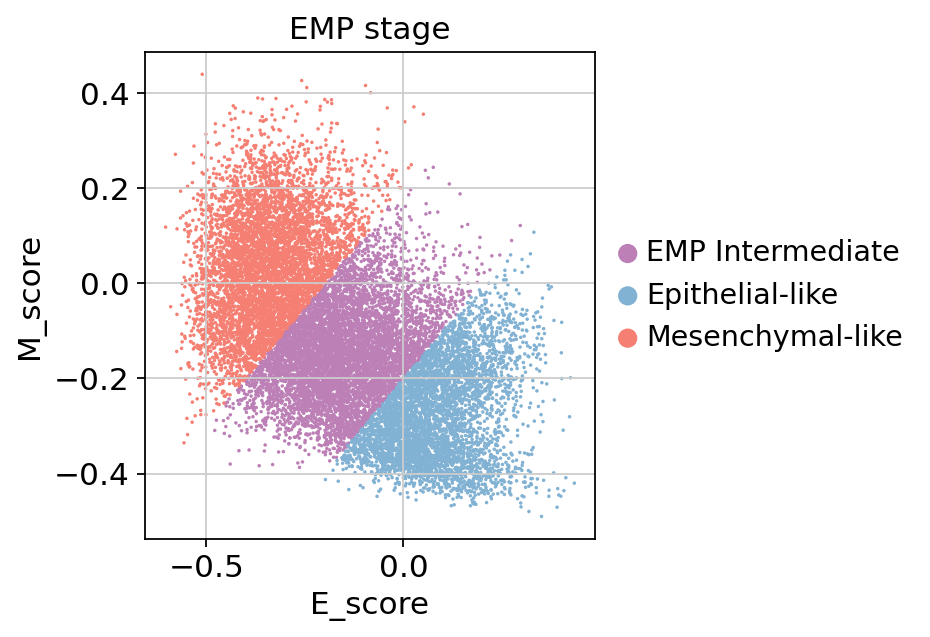

In [50]:
sc.pl.scatter(adata_processed, x='E_score',y='M_score',color='EMP_stage',size=10)

In [51]:
adata_processed

AnnData object with n_obs × n_vars = 16862 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'louvain', 'leiden', 'umap', 'Tumor_ID_colors', 'ER_receptor_colors', 'run_id_colors', 'sort_colors', 'intrinsic_BC_type_colors', 'ranking_ID_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'decontX_counts', 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

In [52]:
adata_processed.write_h5ad('MULTI_processed.h5ad')

# Individual Tumor

## HCI002

In [53]:
adata_HCI002 = adata_processed[adata_processed.obs['Tumor_ID'] == 'HCI002']

In [54]:
adata_HCI002

View of AnnData object with n_obs × n_vars = 371 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'louvain', 'leiden', 'umap', 'Tumor_ID_colors', 'ER_receptor_colors', 'run_id_colors', 'sort_colors', 'intrinsic_BC_type_colors', 'ranking_ID_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'decontX_counts', 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

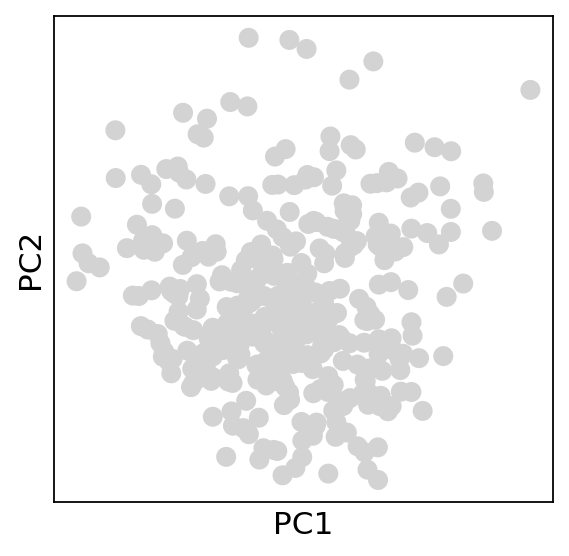

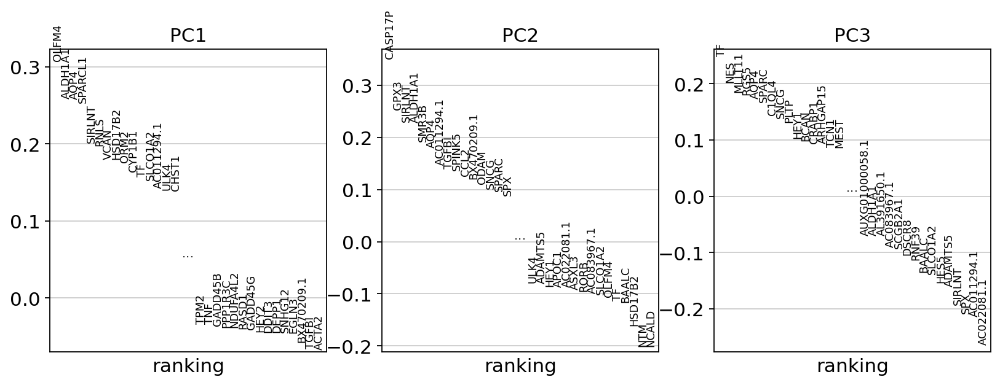

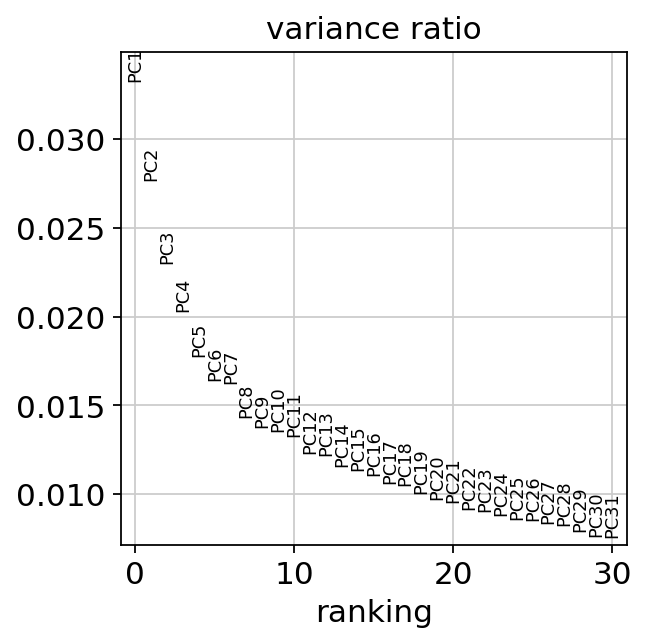

In [55]:
sc.tl.pca(adata_HCI002, svd_solver='auto')
sc.pl.pca_overview(adata_HCI002)

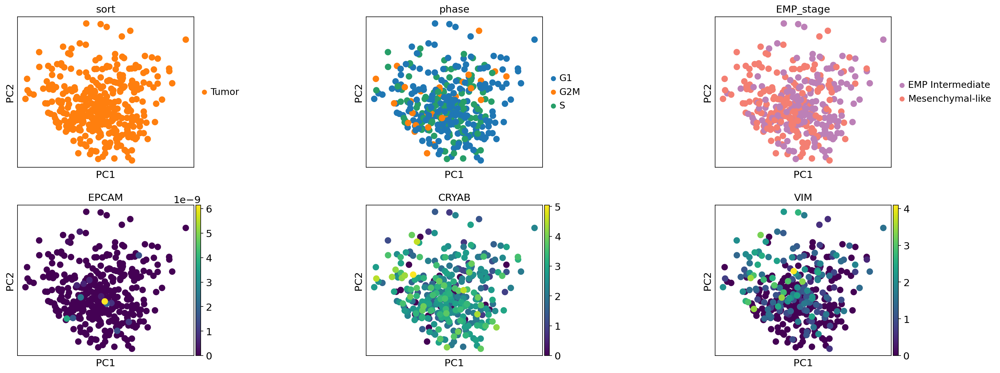

In [56]:
sc.pl.pca(adata_HCI002, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [57]:
sc.pp.neighbors(adata_HCI002, n_neighbors=15, n_pcs=31)
sc.tl.louvain(adata_HCI002, resolution = .5)
sc.tl.leiden(adata_HCI002, resolution = .5)

In [58]:
sc.tl.umap(adata_HCI002)

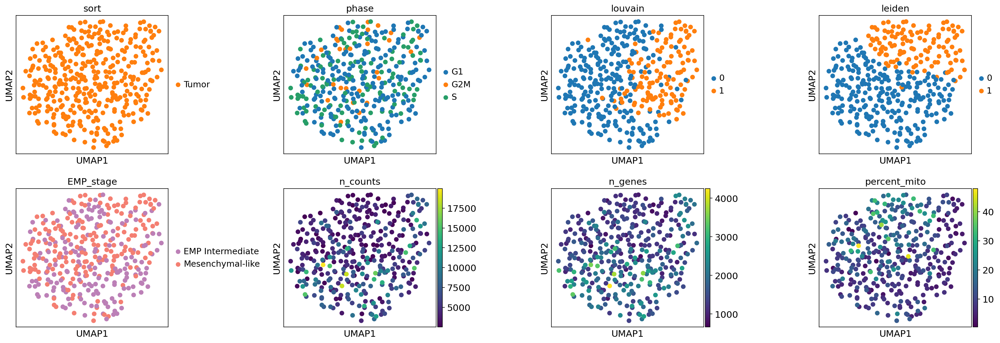

In [59]:
sc.pl.umap(adata_HCI002, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

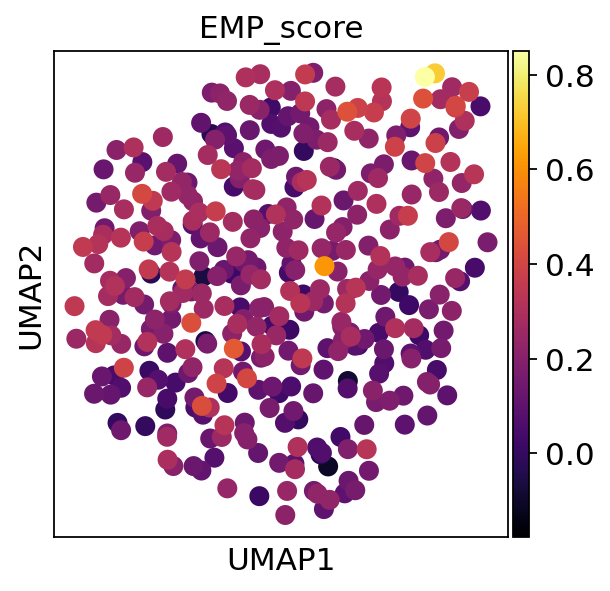

In [60]:
sc.pl.umap(adata_HCI002, color=['EMP_score'],color_map='inferno')

In [61]:
adata_HCI002.write_h5ad('MULTI_HCI002.h5ad')

## HCI005

In [62]:
adata_HCI005 = adata_processed[adata_processed.obs['Tumor_ID'] == 'HCI005']

In [63]:
adata_HCI005

View of AnnData object with n_obs × n_vars = 1442 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'louvain', 'leiden', 'umap', 'Tumor_ID_colors', 'ER_receptor_colors', 'run_id_colors', 'sort_colors', 'intrinsic_BC_type_colors', 'ranking_ID_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'decontX_counts', 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

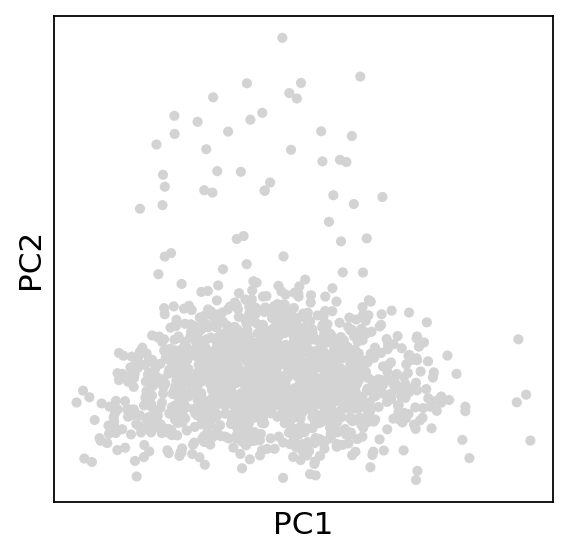

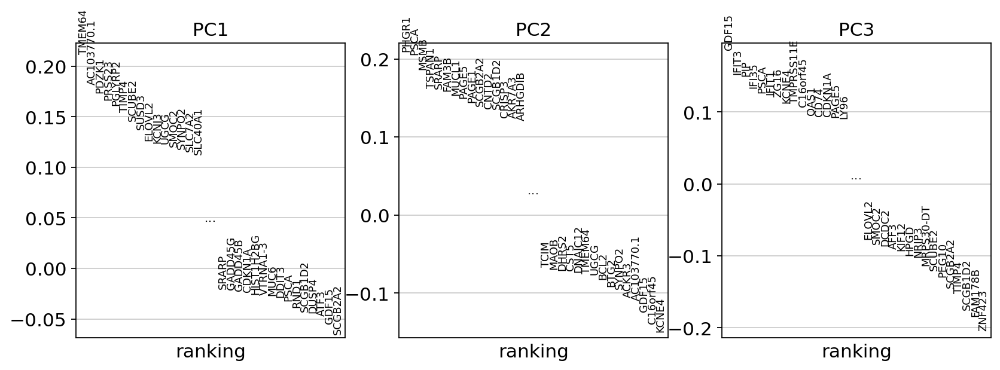

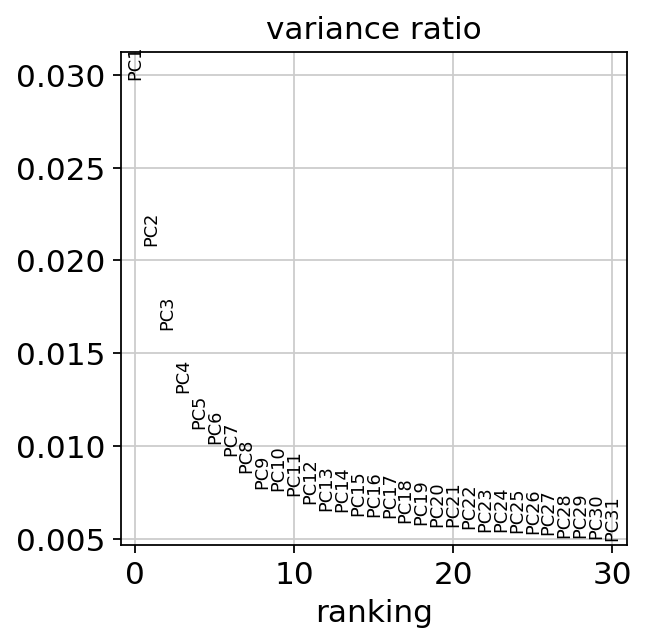

In [64]:
sc.tl.pca(adata_HCI005, svd_solver='auto')
sc.pl.pca_overview(adata_HCI005)

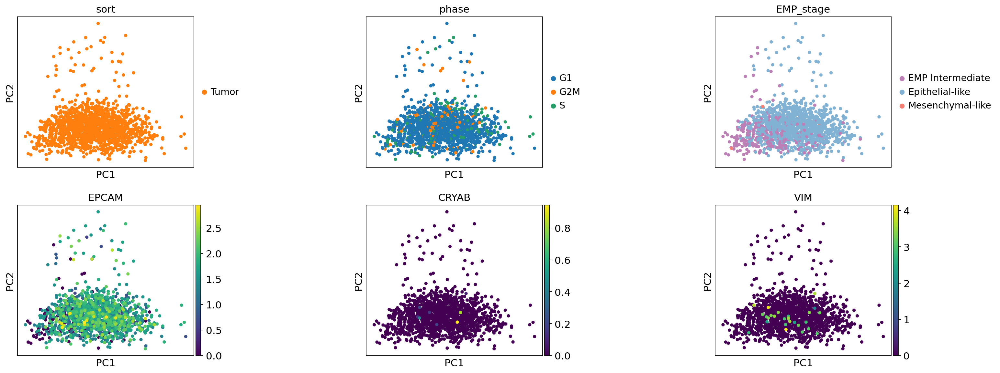

In [65]:
sc.pl.pca(adata_HCI005, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [66]:
sc.pp.neighbors(adata_HCI005, n_neighbors=15, n_pcs=30)
sc.tl.louvain(adata_HCI005, resolution = .5)
sc.tl.leiden(adata_HCI005, resolution = .5)

In [67]:
sc.tl.umap(adata_HCI005)

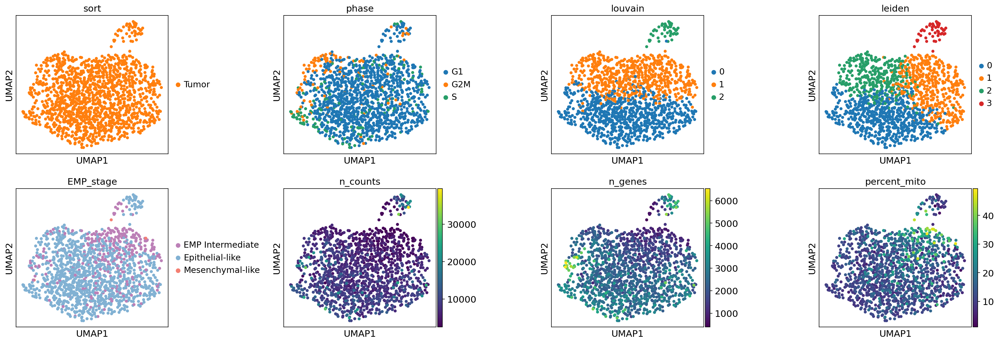

In [68]:
sc.pl.umap(adata_HCI005, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6)

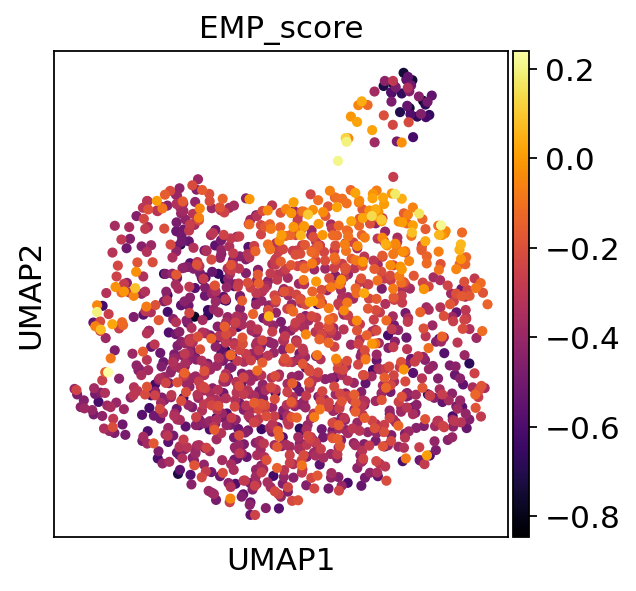

In [69]:
sc.pl.umap(adata_HCI005, color=['EMP_score'],color_map='inferno')

In [70]:
adata_HCI005.write_h5ad('MULTI_HCI005.h5ad')

## H4272

In [71]:
adata_H4272 = adata_processed[adata_processed.obs['Tumor_ID'] == 'H4272']

In [72]:
adata_H4272

View of AnnData object with n_obs × n_vars = 4040 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'louvain', 'leiden', 'umap', 'Tumor_ID_colors', 'ER_receptor_colors', 'run_id_colors', 'sort_colors', 'intrinsic_BC_type_colors', 'ranking_ID_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'decontX_counts', 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

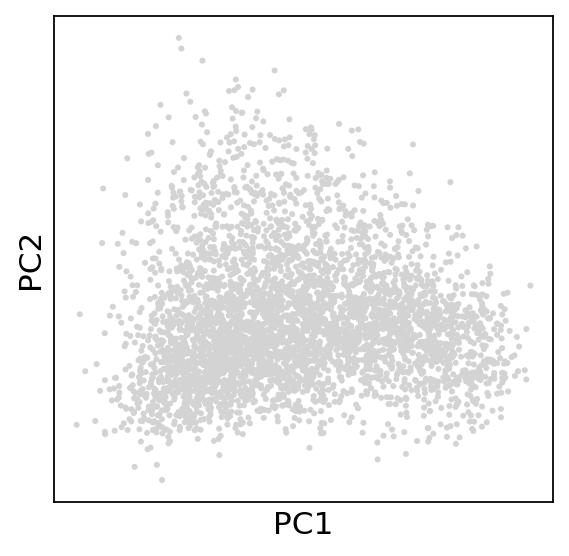

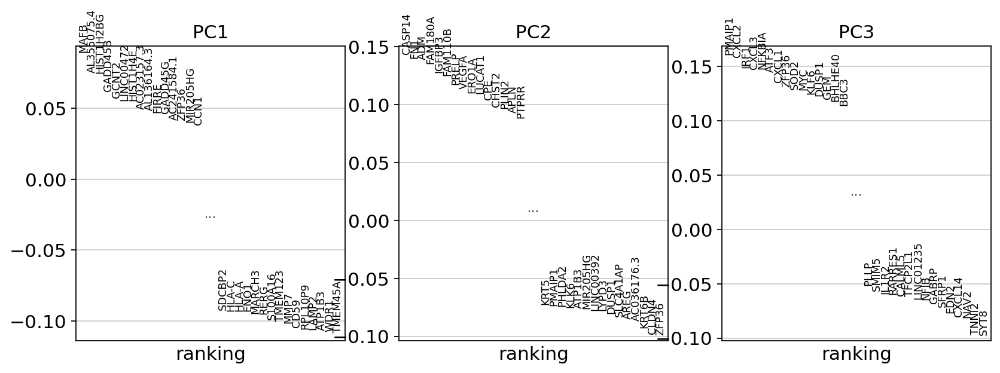

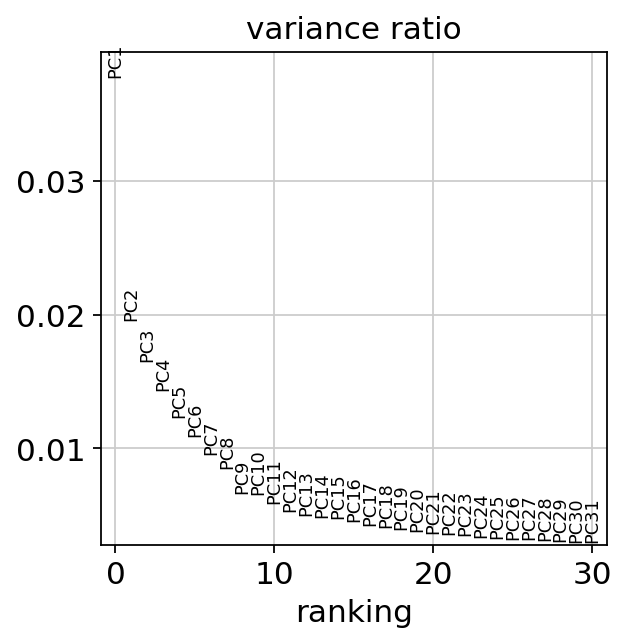

In [73]:
sc.tl.pca(adata_H4272, svd_solver='auto')
sc.pl.pca_overview(adata_H4272)

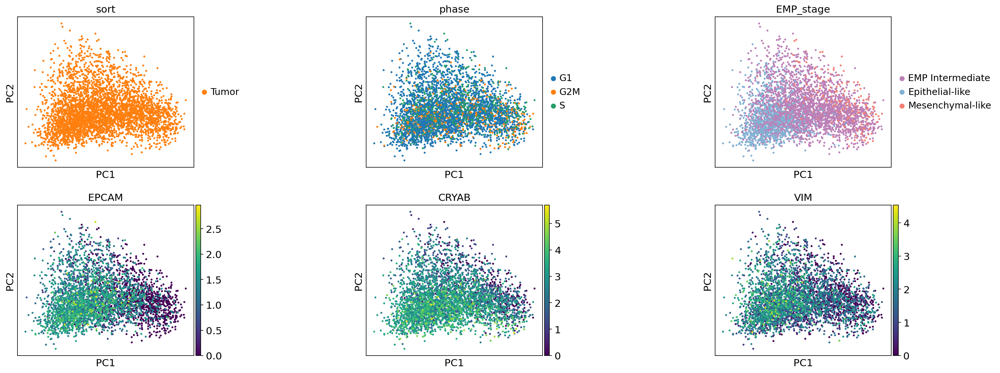

In [74]:
sc.pl.pca(adata_H4272, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [75]:
sc.pp.neighbors(adata_H4272, n_neighbors=25, n_pcs=30)
sc.tl.louvain(adata_H4272, resolution = .4)
sc.tl.leiden(adata_H4272, resolution = .4)

In [76]:
sc.tl.umap(adata_H4272)

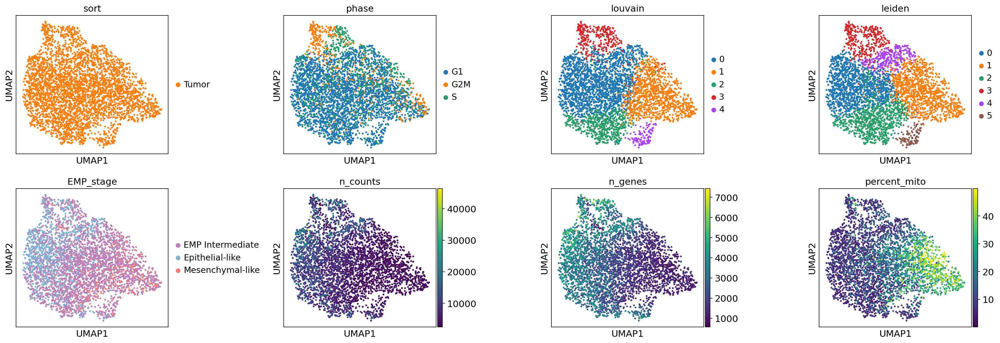

In [77]:
sc.pl.umap(adata_H4272, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6)

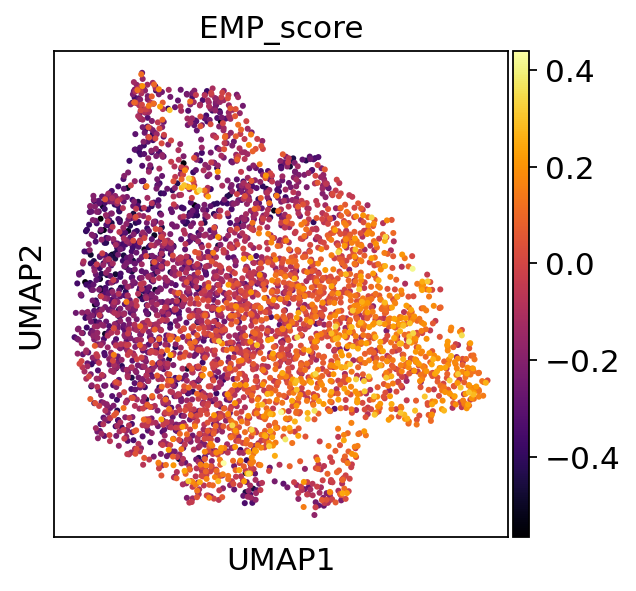

In [78]:
sc.pl.umap(adata_H4272, color=['EMP_score'],color_map='inferno')

In [79]:
adata_H4272.write_h5ad('MULTI_H4272.h5ad')

## J55454

In [80]:
adata_J55454 = adata_processed[adata_processed.obs['Tumor_ID'] == 'J55454']

In [81]:
adata_J55454

View of AnnData object with n_obs × n_vars = 157 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'louvain', 'leiden', 'umap', 'Tumor_ID_colors', 'ER_receptor_colors', 'run_id_colors', 'sort_colors', 'intrinsic_BC_type_colors', 'ranking_ID_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'decontX_counts', 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

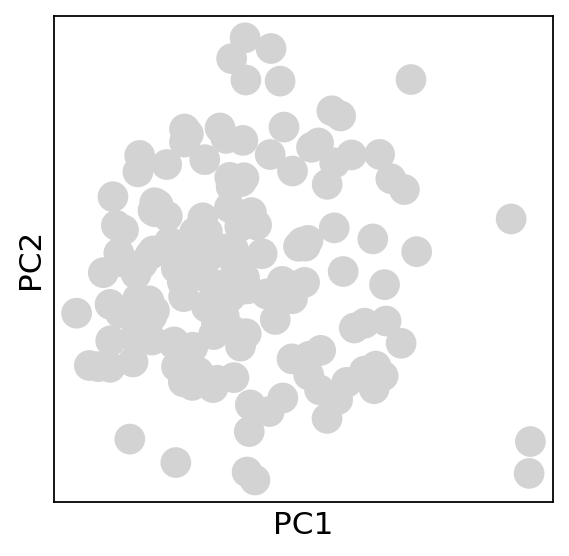

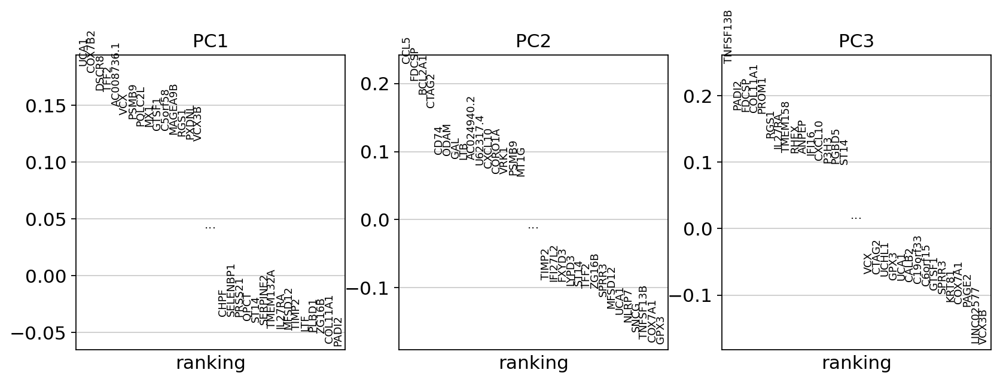

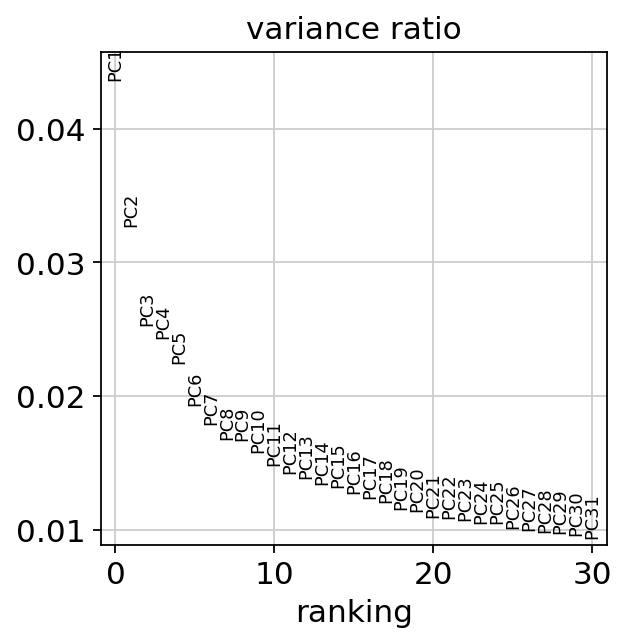

In [82]:
sc.tl.pca(adata_J55454, svd_solver='auto')
sc.pl.pca_overview(adata_J55454)

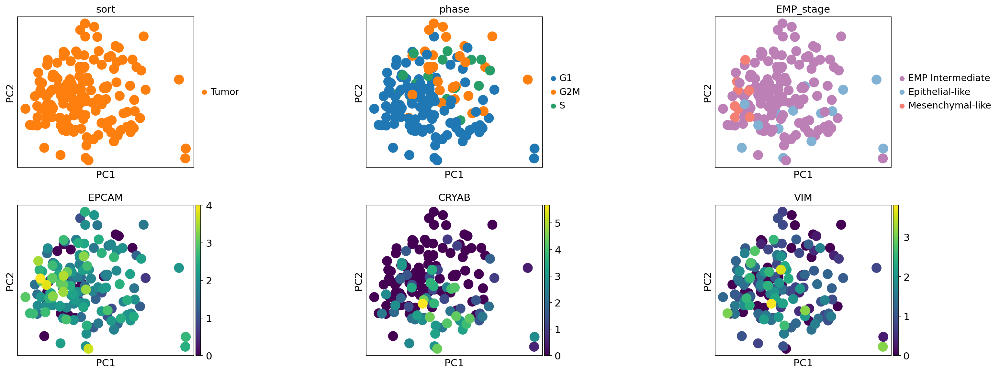

In [83]:
sc.pl.pca(adata_J55454, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [84]:
sc.pp.neighbors(adata_J55454, n_neighbors=15, n_pcs=31)
sc.tl.louvain(adata_J55454, resolution = .5)
sc.tl.leiden(adata_J55454, resolution = .5)

In [85]:
sc.tl.umap(adata_J55454)

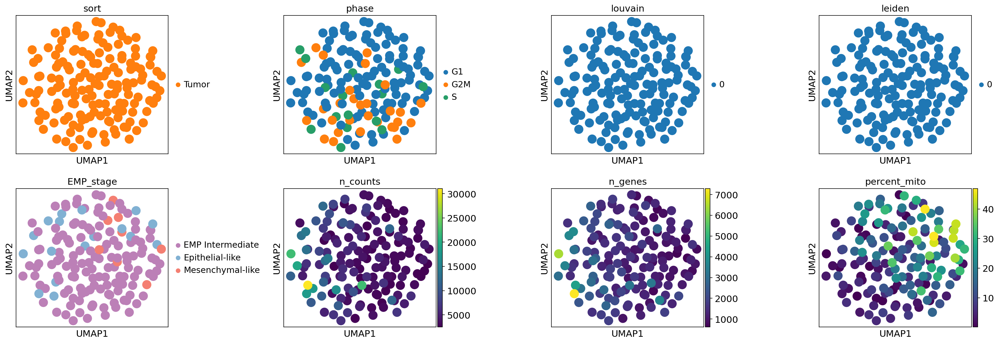

In [86]:
sc.pl.umap(adata_J55454, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6)

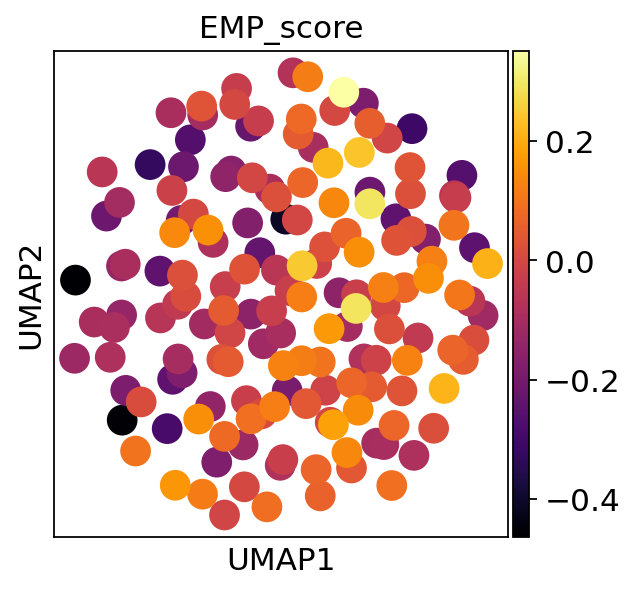

In [87]:
sc.pl.umap(adata_J55454, color=['EMP_score'],color_map='inferno')

In [88]:
adata_J55454.write_h5ad('MULTI_J55454.h5ad')

## HCI011

In [89]:
adata_HCI011 = adata_processed[adata_processed.obs['Tumor_ID'] == 'HCI011']

In [90]:
adata_HCI011

View of AnnData object with n_obs × n_vars = 937 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'louvain', 'leiden', 'umap', 'Tumor_ID_colors', 'ER_receptor_colors', 'run_id_colors', 'sort_colors', 'intrinsic_BC_type_colors', 'ranking_ID_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'decontX_counts', 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

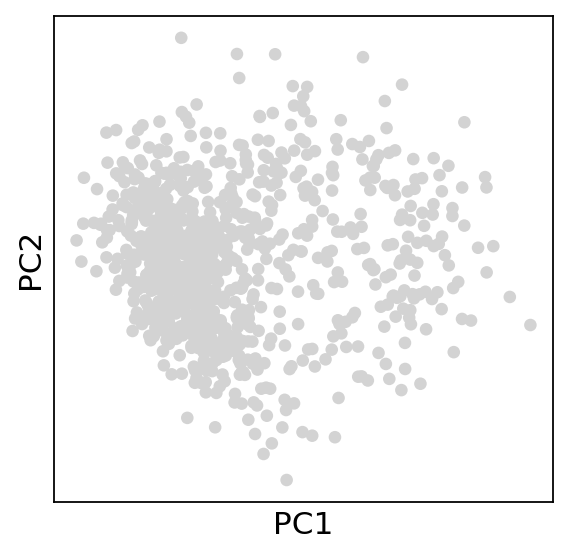

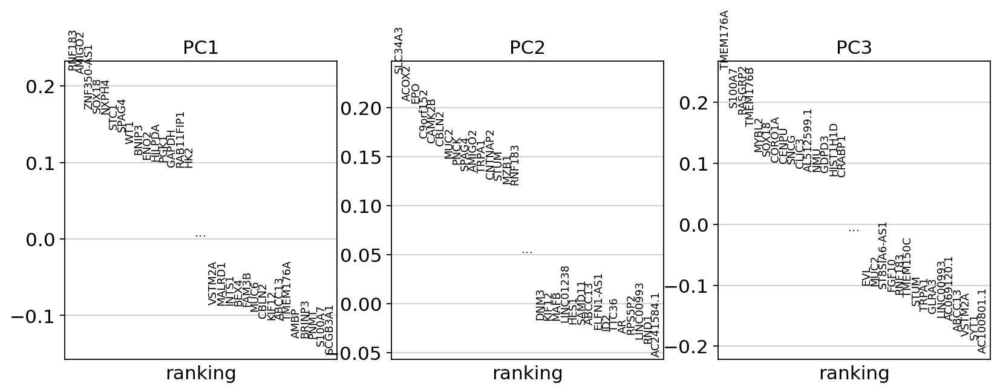

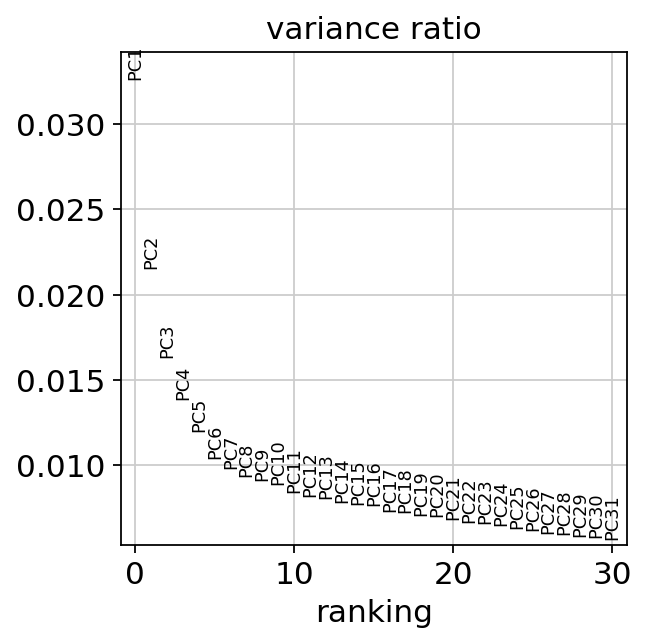

In [91]:
sc.tl.pca(adata_HCI011, svd_solver='auto')
sc.pl.pca_overview(adata_HCI011)

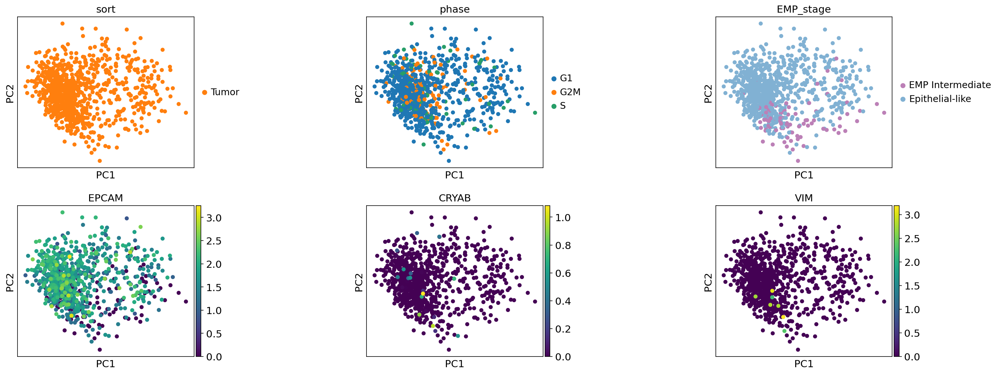

In [92]:
sc.pl.pca(adata_HCI011, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [93]:
sc.pp.neighbors(adata_HCI011, n_neighbors=15, n_pcs=31)
sc.tl.louvain(adata_HCI011, resolution = .5)
sc.tl.leiden(adata_HCI011, resolution = .5)

In [94]:
sc.tl.umap(adata_HCI011)

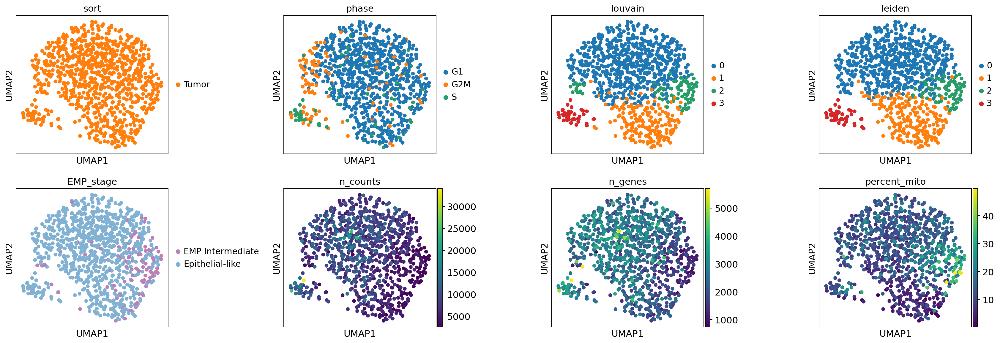

In [95]:
sc.pl.umap(adata_HCI011, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6)

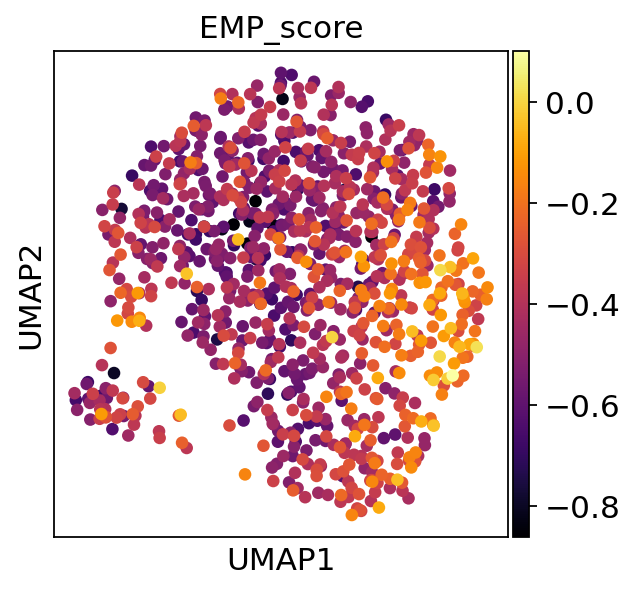

In [96]:
sc.pl.umap(adata_HCI011, color=['EMP_score'],color_map='inferno')

In [97]:
adata_HCI011.write_h5ad('MULTI_HCI011.h5ad')

## HCI001

In [98]:
adata_HCI001 = adata_processed[adata_processed.obs['Tumor_ID'] == 'HCI001']

In [99]:
adata_HCI001

View of AnnData object with n_obs × n_vars = 3088 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'louvain', 'leiden', 'umap', 'Tumor_ID_colors', 'ER_receptor_colors', 'run_id_colors', 'sort_colors', 'intrinsic_BC_type_colors', 'ranking_ID_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'decontX_counts', 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

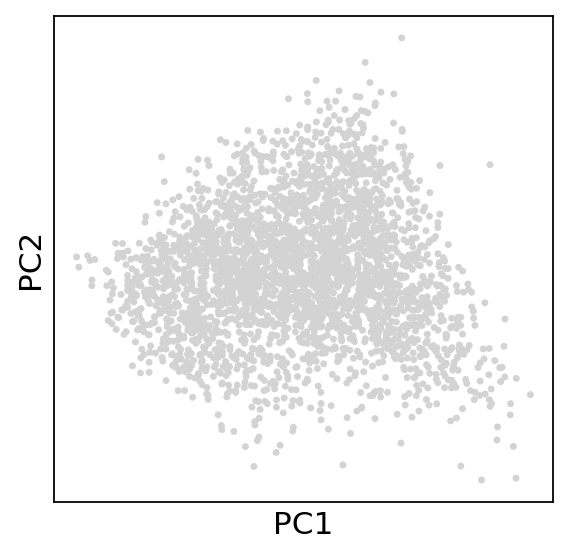

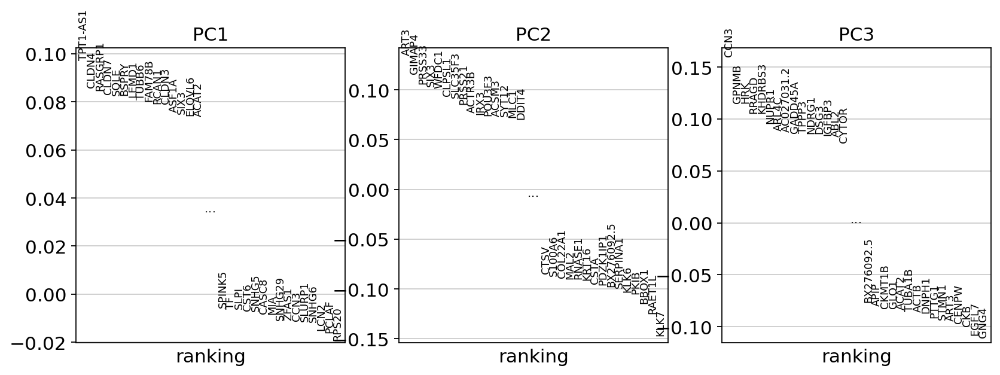

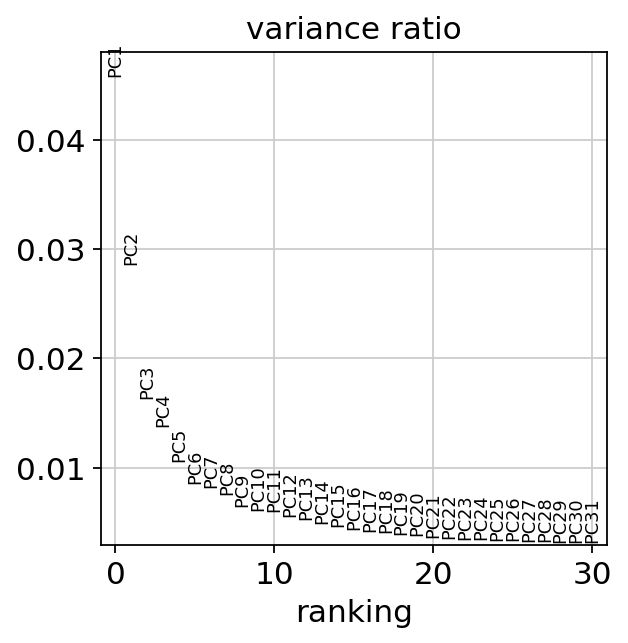

In [100]:
sc.tl.pca(adata_HCI001, svd_solver='auto')
sc.pl.pca_overview(adata_HCI001)

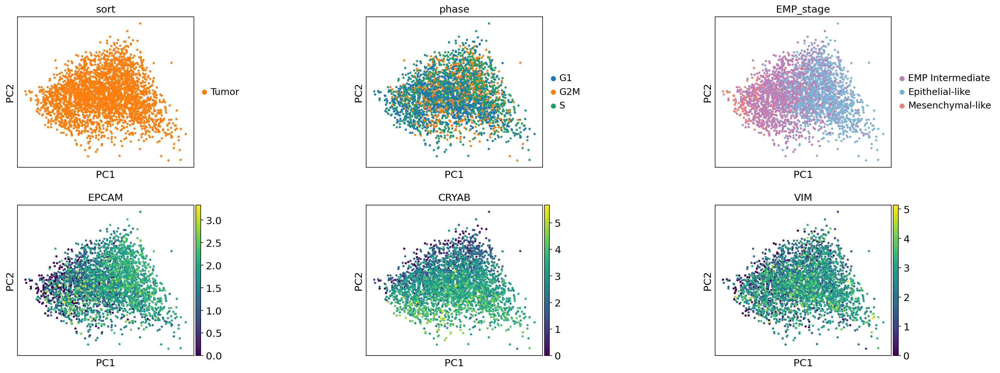

In [101]:
sc.pl.pca(adata_HCI001, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [102]:
sc.pp.neighbors(adata_HCI001, n_neighbors=15, n_pcs=25)
sc.tl.louvain(adata_HCI001, resolution = .3)
sc.tl.leiden(adata_HCI001, resolution = .3)

In [103]:
sc.tl.umap(adata_HCI001)

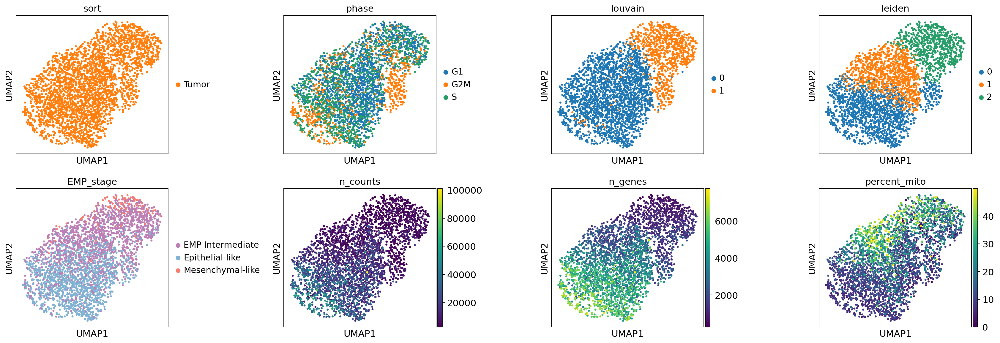

In [104]:
sc.pl.umap(adata_HCI001, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6)

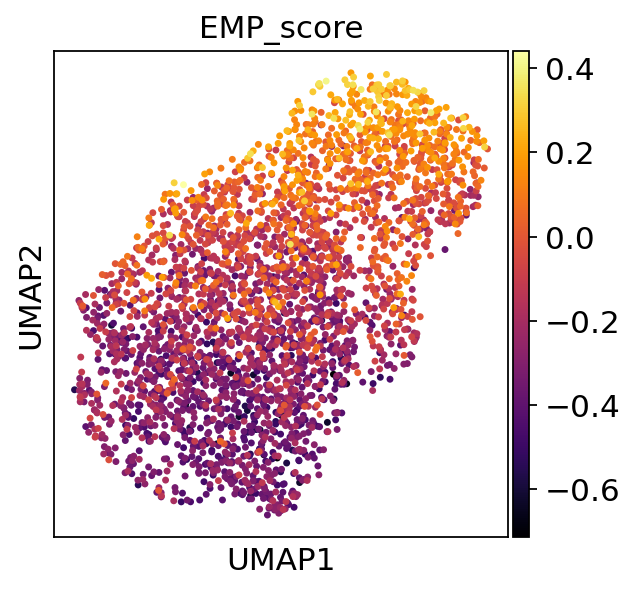

In [105]:
sc.pl.umap(adata_HCI001, color=['EMP_score'],color_map='inferno')

In [106]:
adata_HCI001.write_h5ad('MULTI_HCI001.h5ad')

## H5097

In [107]:
adata_H5097 = adata_processed[adata_processed.obs['Tumor_ID'] == 'H5097']

In [108]:
adata_H5097

View of AnnData object with n_obs × n_vars = 258 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'louvain', 'leiden', 'umap', 'Tumor_ID_colors', 'ER_receptor_colors', 'run_id_colors', 'sort_colors', 'intrinsic_BC_type_colors', 'ranking_ID_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'decontX_counts', 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

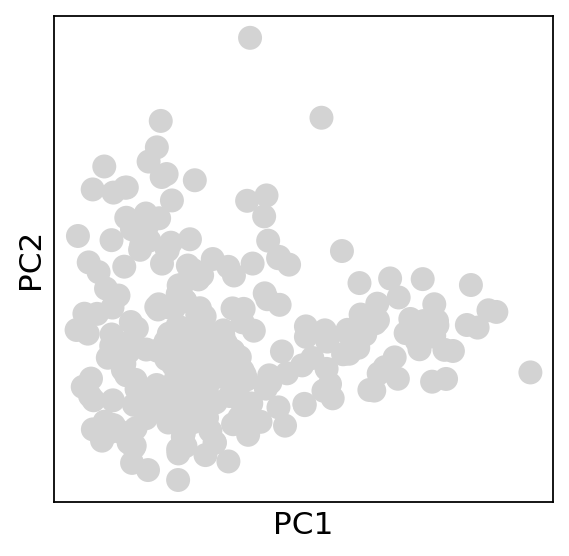

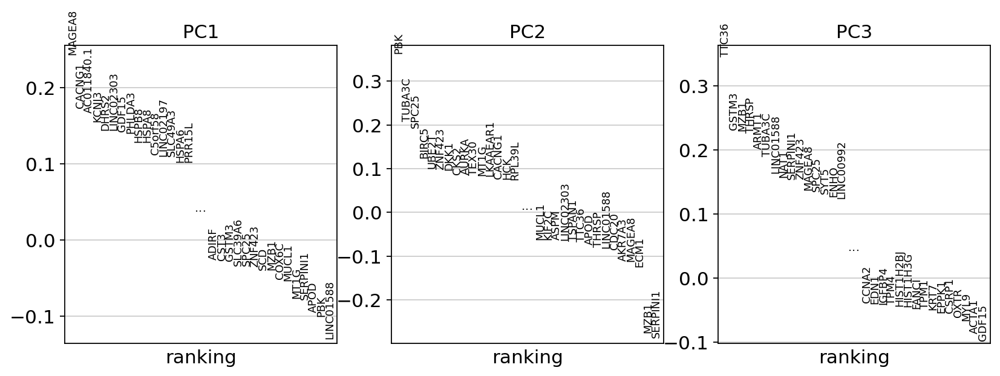

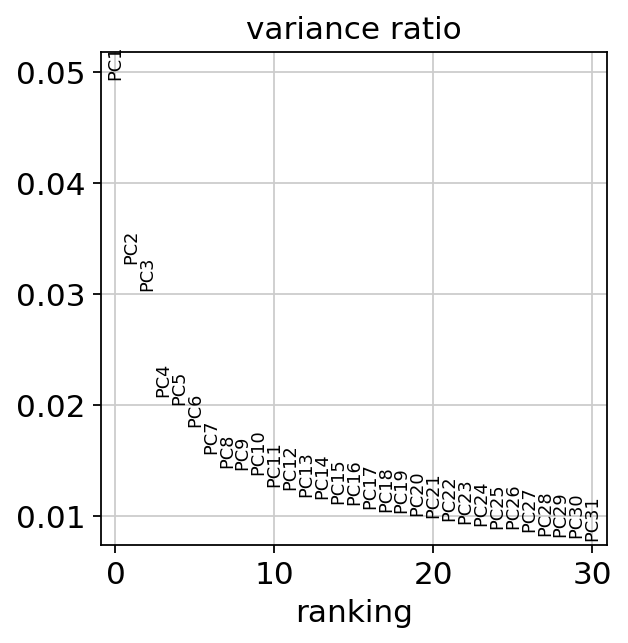

In [109]:
sc.tl.pca(adata_H5097, svd_solver='auto')
sc.pl.pca_overview(adata_H5097)

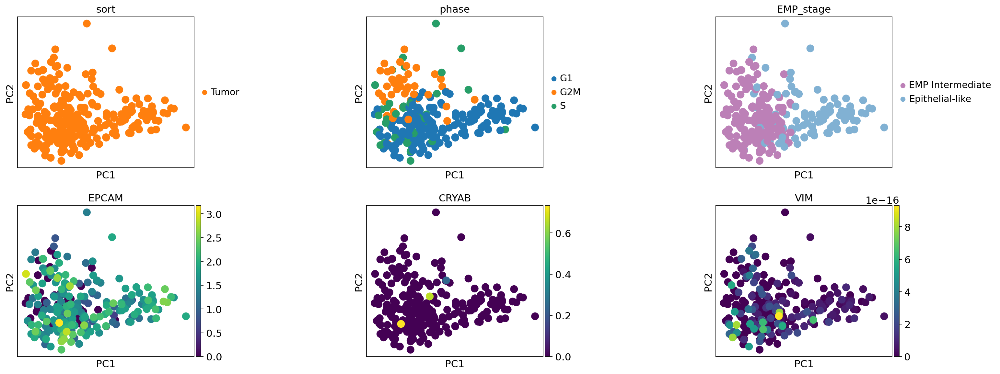

In [110]:
sc.pl.pca(adata_H5097, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [111]:
sc.pp.neighbors(adata_H5097, n_neighbors=15, n_pcs=30)
sc.tl.louvain(adata_H5097, resolution = .5)
sc.tl.leiden(adata_H5097, resolution = .5)

In [112]:
sc.tl.umap(adata_H5097)

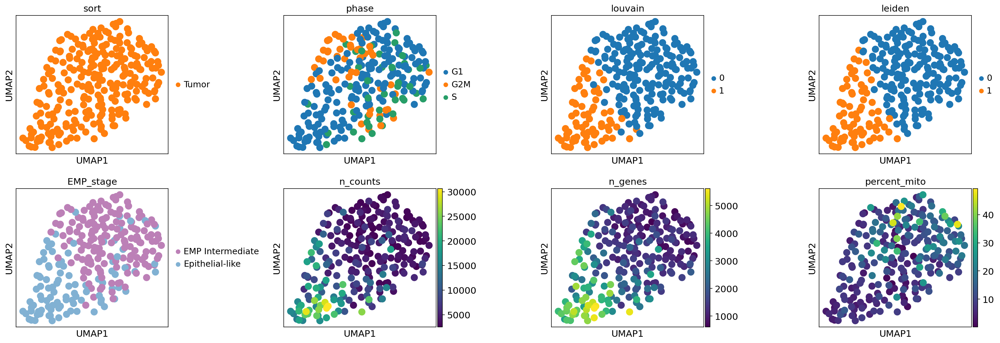

In [113]:
sc.pl.umap(adata_H5097, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6)

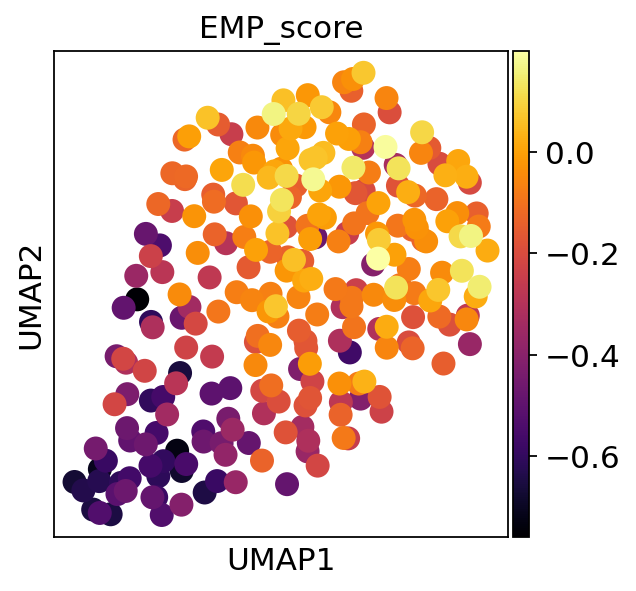

In [114]:
sc.pl.umap(adata_H5097, color=['EMP_score'],color_map='inferno')

In [115]:
adata_H5097.write_h5ad('MULTI_H5097.h5ad')

## J2036

In [116]:
adata_J2036 = adata_processed[adata_processed.obs['Tumor_ID'] == 'J2036']

In [117]:
adata_J2036

View of AnnData object with n_obs × n_vars = 92 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'louvain', 'leiden', 'umap', 'Tumor_ID_colors', 'ER_receptor_colors', 'run_id_colors', 'sort_colors', 'intrinsic_BC_type_colors', 'ranking_ID_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'decontX_counts', 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

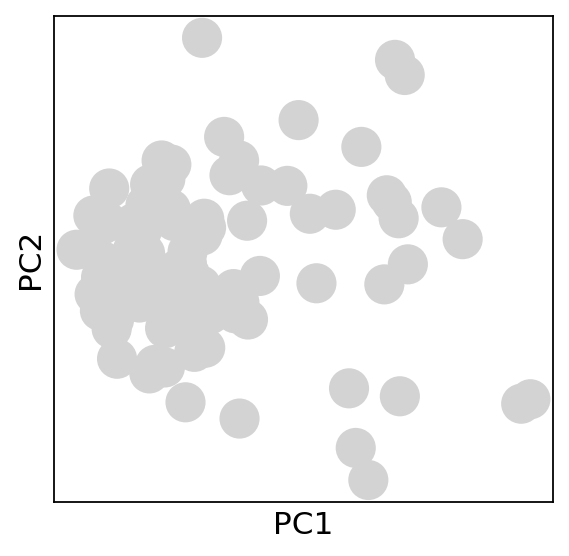

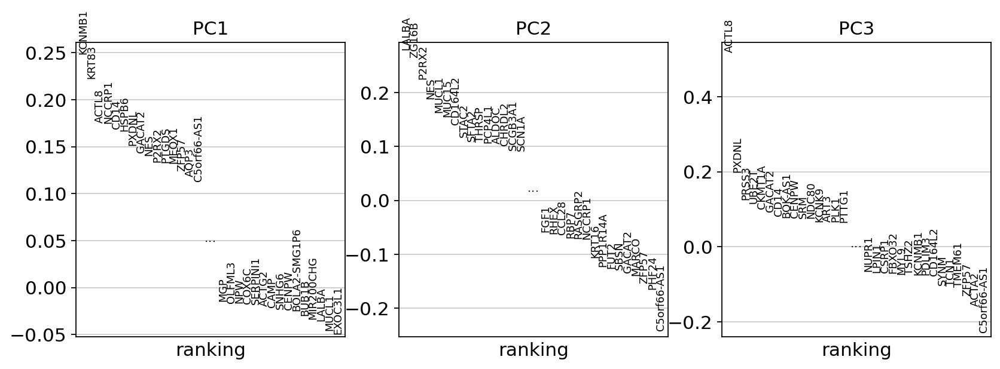

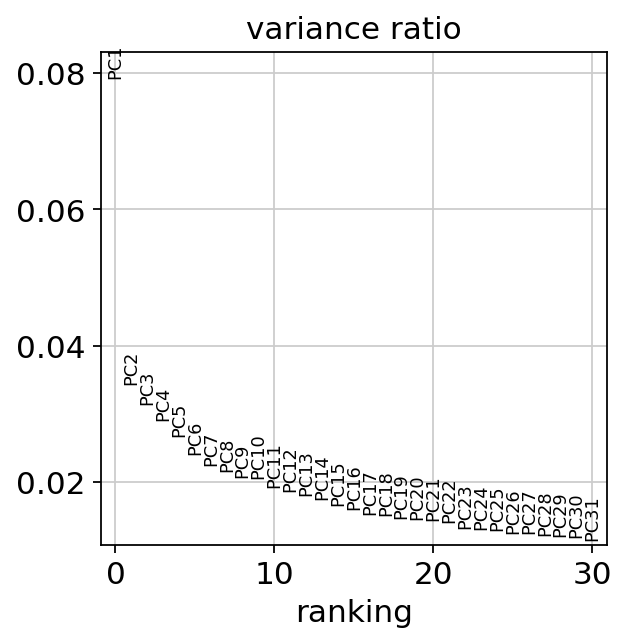

In [118]:
sc.tl.pca(adata_J2036, svd_solver='auto')
sc.pl.pca_overview(adata_J2036)

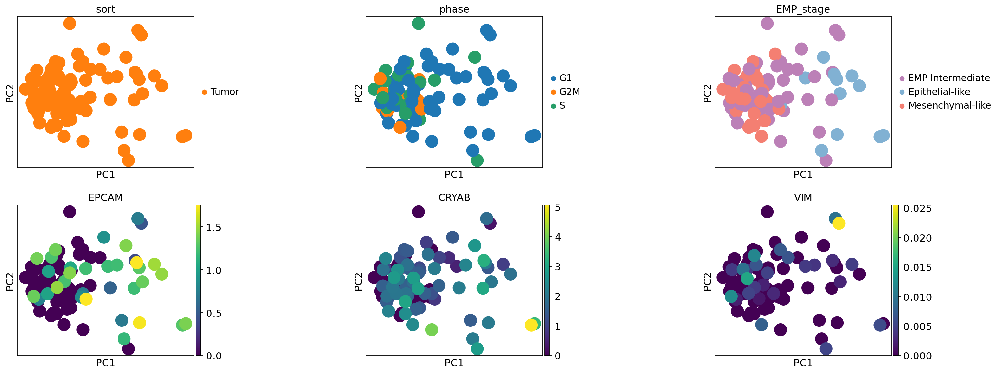

In [119]:
sc.pl.pca(adata_J2036, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [120]:
sc.pp.neighbors(adata_J2036, n_neighbors=15, n_pcs=30)
sc.tl.louvain(adata_J2036, resolution = .5)
sc.tl.leiden(adata_J2036, resolution = .5)

In [121]:
sc.tl.umap(adata_J2036)

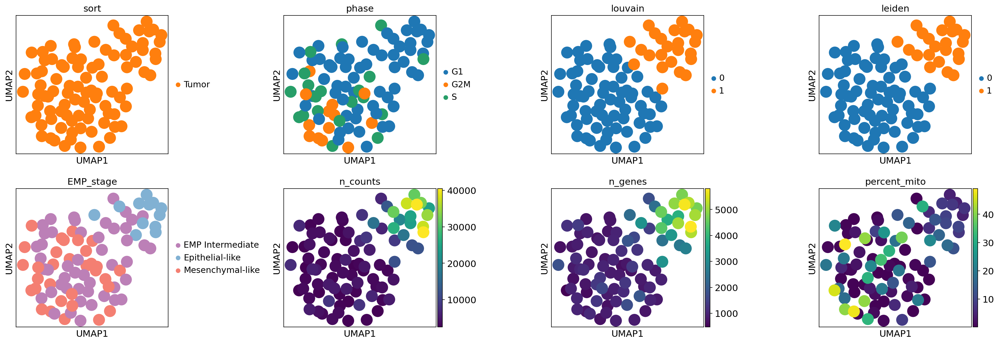

In [122]:
sc.pl.umap(adata_J2036, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6)

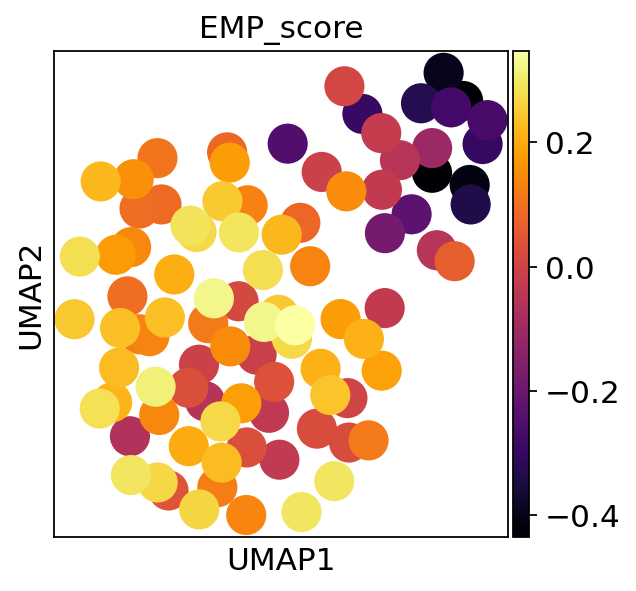

In [123]:
sc.pl.umap(adata_J2036, color=['EMP_score'],color_map='inferno')

In [124]:
adata_J2036.write_h5ad('MULTI_J2036.h5ad')

## J53353

In [125]:
adata_J53353 = adata_processed[adata_processed.obs['Tumor_ID'] == 'J53353']

In [126]:
adata_J53353

View of AnnData object with n_obs × n_vars = 4670 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'louvain', 'leiden', 'umap', 'Tumor_ID_colors', 'ER_receptor_colors', 'run_id_colors', 'sort_colors', 'intrinsic_BC_type_colors', 'ranking_ID_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'decontX_counts', 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

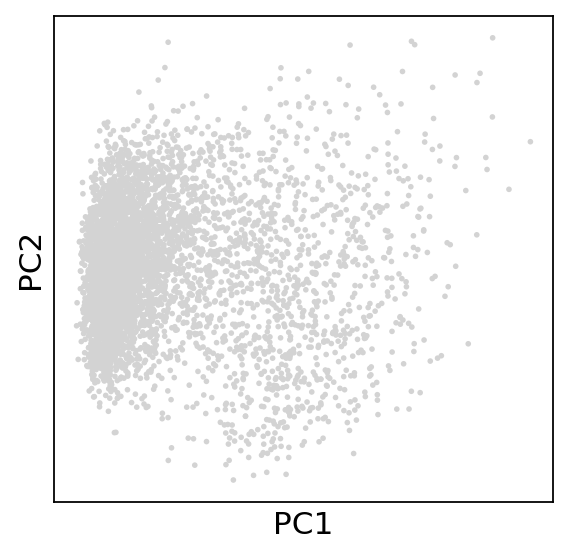

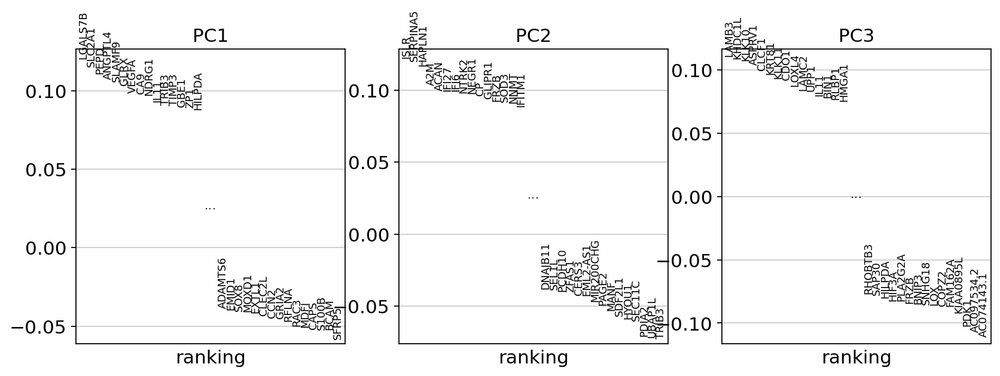

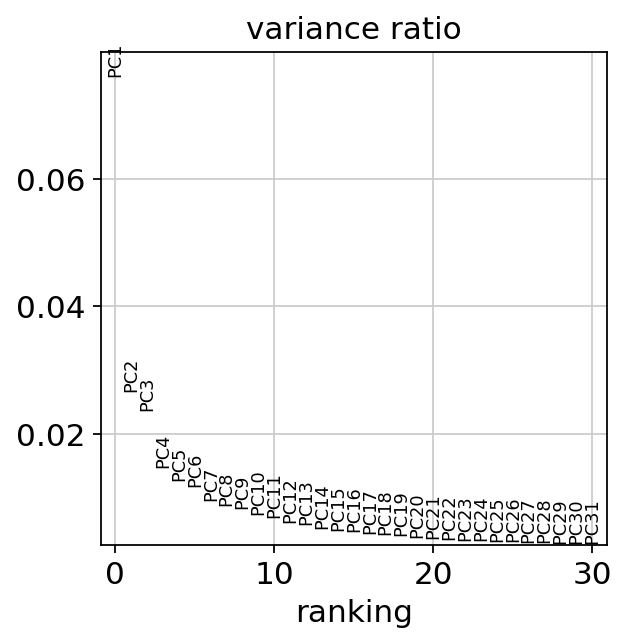

In [127]:
sc.tl.pca(adata_J53353, svd_solver='auto')
sc.pl.pca_overview(adata_J53353)

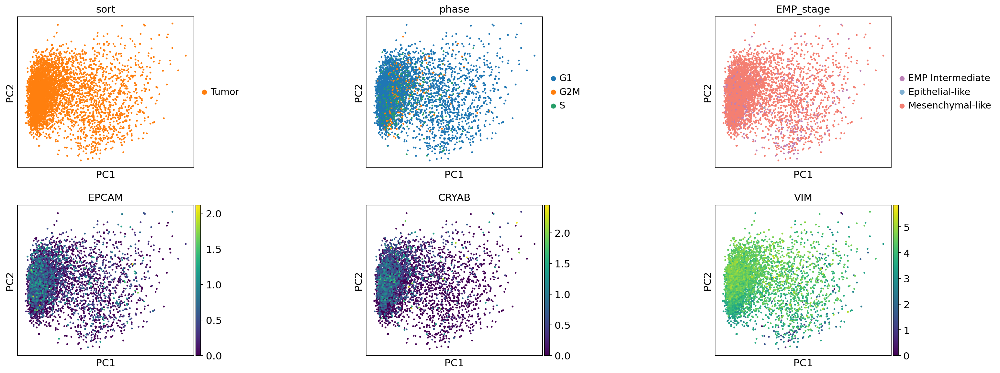

In [128]:
sc.pl.pca(adata_J53353, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [129]:
sc.pp.neighbors(adata_J53353, n_neighbors=20, n_pcs=25)
sc.tl.louvain(adata_J53353, resolution = .3)
sc.tl.leiden(adata_J53353, resolution = .3)

In [130]:
sc.tl.umap(adata_J53353)

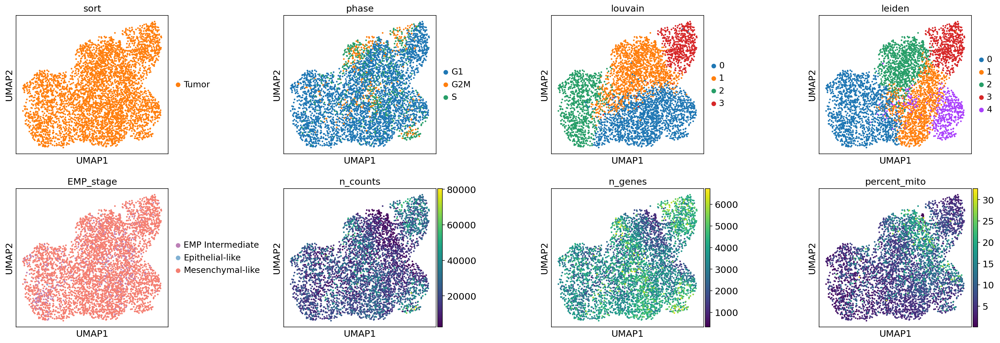

In [131]:
sc.pl.umap(adata_J53353, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6)

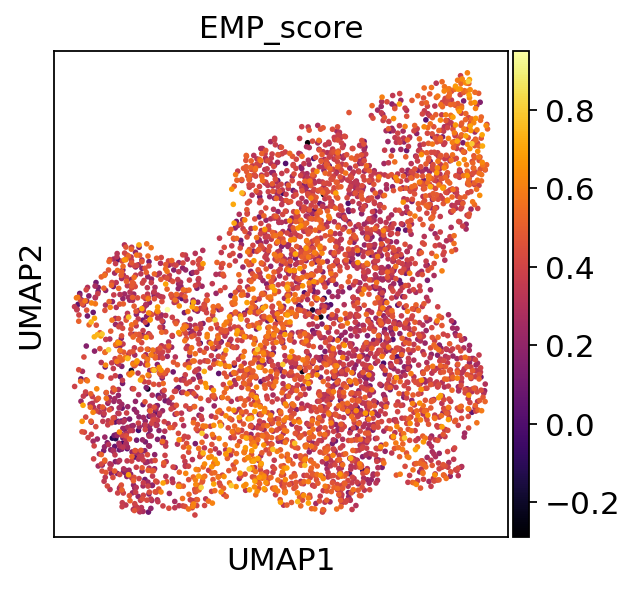

In [132]:
sc.pl.umap(adata_J53353, color=['EMP_score'],color_map='inferno')

In [133]:
adata_J53353.write_h5ad('MULTI_J53353.h5ad')

## HCI010

In [134]:
adata_HCI010 = adata_processed[adata_processed.obs['Tumor_ID'] == 'HCI010']

In [135]:
adata_HCI010

View of AnnData object with n_obs × n_vars = 1807 × 21638
    obs: 'n_counts', 'n_genes', 'percent_mito', 'MULTI_barcode', 'MULTI_tumor_ID', 'MULTI_sort', 'Tumor_ID', 'run_id', 'sequencing_batch', 'sort', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'ranking_ID', 'metastatic_potential_rank', 'metastatic_potential_group', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'louvain', 'leiden', 'umap', 'Tumor_ID_colors', 'ER_receptor_colors', 'run_id_colors', 'sort_colors', 'intrinsic_BC_type_colors', 'ranking_ID_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'decontX_counts', 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

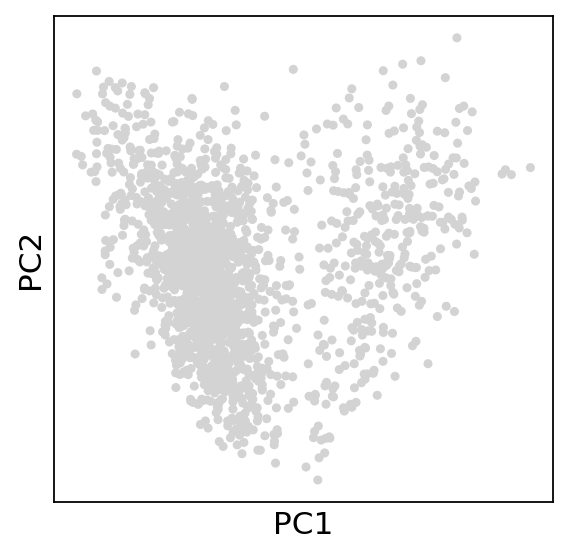

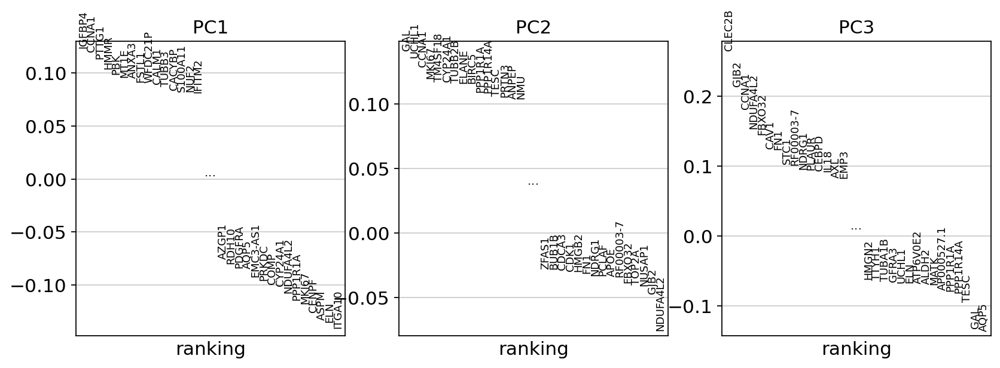

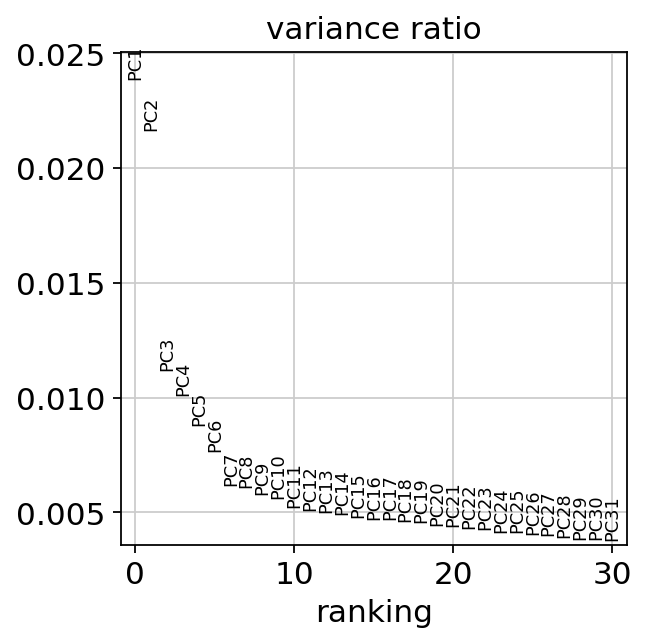

In [136]:
sc.tl.pca(adata_HCI010, svd_solver='auto')
sc.pl.pca_overview(adata_HCI010)

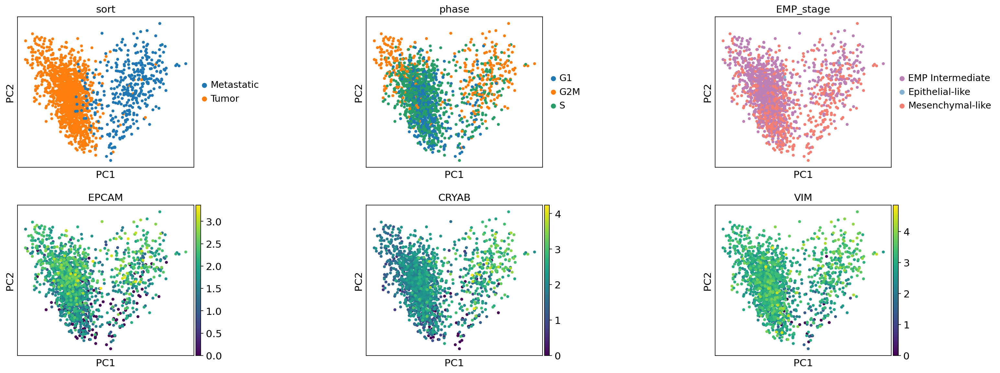

In [137]:
sc.pl.pca(adata_HCI010, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [138]:
sc.pp.neighbors(adata_HCI010, n_neighbors=15, n_pcs=25)
sc.tl.louvain(adata_HCI010, resolution = .3)
sc.tl.leiden(adata_HCI010, resolution = .3)

In [139]:
sc.tl.umap(adata_HCI010)

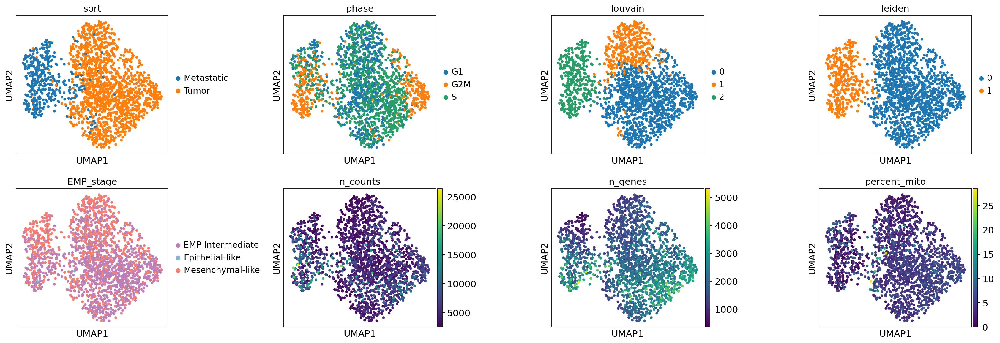

In [140]:
sc.pl.umap(adata_HCI010, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6)

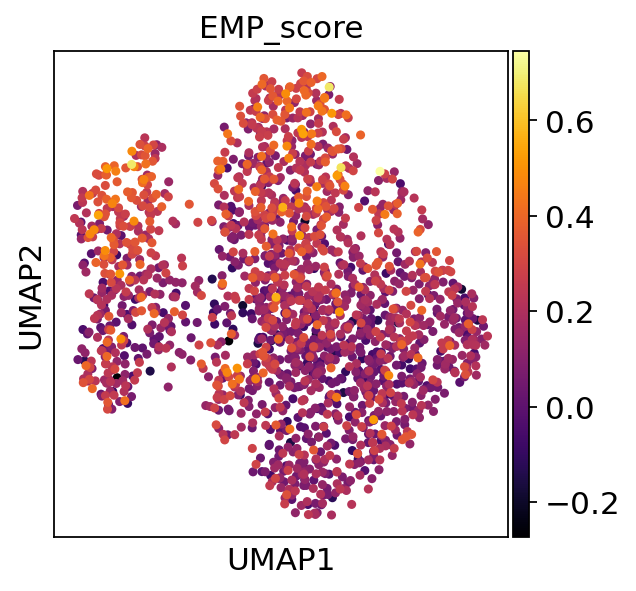

In [141]:
sc.pl.umap(adata_HCI010, color=['EMP_score'],color_map='inferno')

In [142]:
adata_HCI010.write_h5ad('MULTI_HCI010.h5ad')